In [1]:
import sys
print(sys.version)
print(sys.executable)

3.8.17 (default, Jul  5 2023, 21:04:15) 
[GCC 11.2.0]
/public3/home/scg6055/.conda/envs/py38/bin/python


In [2]:
import os
import numpy as np
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt
from matplotlib import rcParams
import seaborn as sns
import anndata as an
# import scanorama
from scipy.sparse import csr_matrix
from deside.single_cell import get_10x_mtx, normalize_mtx
from deside.utility import check_dir
from deside.utility import log_exp2cpm,non_log2cpm,non_log2log_cpm
sns.set()

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/umap/distances.py:1053: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/umap/distances.py:1061: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packag

In [ ]:
# import zipfile
# print(os.path.abspath('.'))
# zip_path = r'../data/3CA/Data_Sun2021_Liver-Biliary/Exp_data_TPM.zip'
# save_path = r'../data/3CA/Data_Sun2021_Liver-Biliary'
# file=zipfile.ZipFile(zip_path)
# print('开始解压')
# file.extractall(save_path)
# print('解压结束')
# file.close()


In [3]:
result_dir = os.path.join(r'../results/3CA/Cheng_2021_Prostate')
data_set_name = str('all_PRAD_Cheng_Cell_2021_merged')
check_dir(result_dir)

In [4]:
gene_name_path = r'../data/3CA/Data_Chen2021_Prostate/Genes.txt'
cell_information_path = r'../data/3CA/Data_Chen2021_Prostate/Cells.csv'
gene_name = pd.read_csv(gene_name_path,sep=',',header =None,index_col=0)
cell_information = pd.read_csv(cell_information_path,sep=',',index_col=0,header =0)
print(gene_name.shape)
print(cell_information.shape)
anno = cell_information.copy()


(25044, 0)
(36424, 3)


In [5]:
data_path = r'../data/3CA/Data_Chen2021_Prostate/Exp_data_UMIcounts.mtx'
all_dataset = sc.read(data_path)
all_dataset = all_dataset.T
print(all_dataset.shape)

(36424, 25044)


12439.0
559402.9850746269


(array([    0.,     0.,     0.,     0.,     0., 36424.,     0.,     0.,
            0.,     0.]),
 array([ 999999.5,  999999.6,  999999.7,  999999.8,  999999.9, 1000000. ,
        1000000.1, 1000000.2, 1000000.3, 1000000.4, 1000000.5]),
 <BarContainer object of 10 artists>)

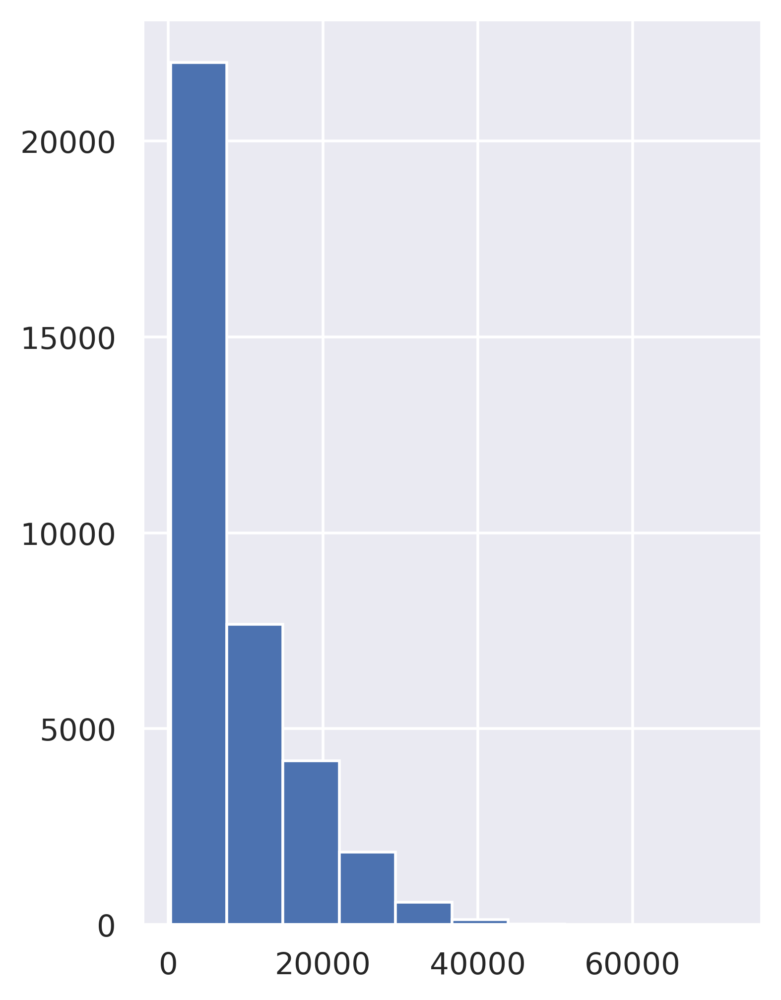

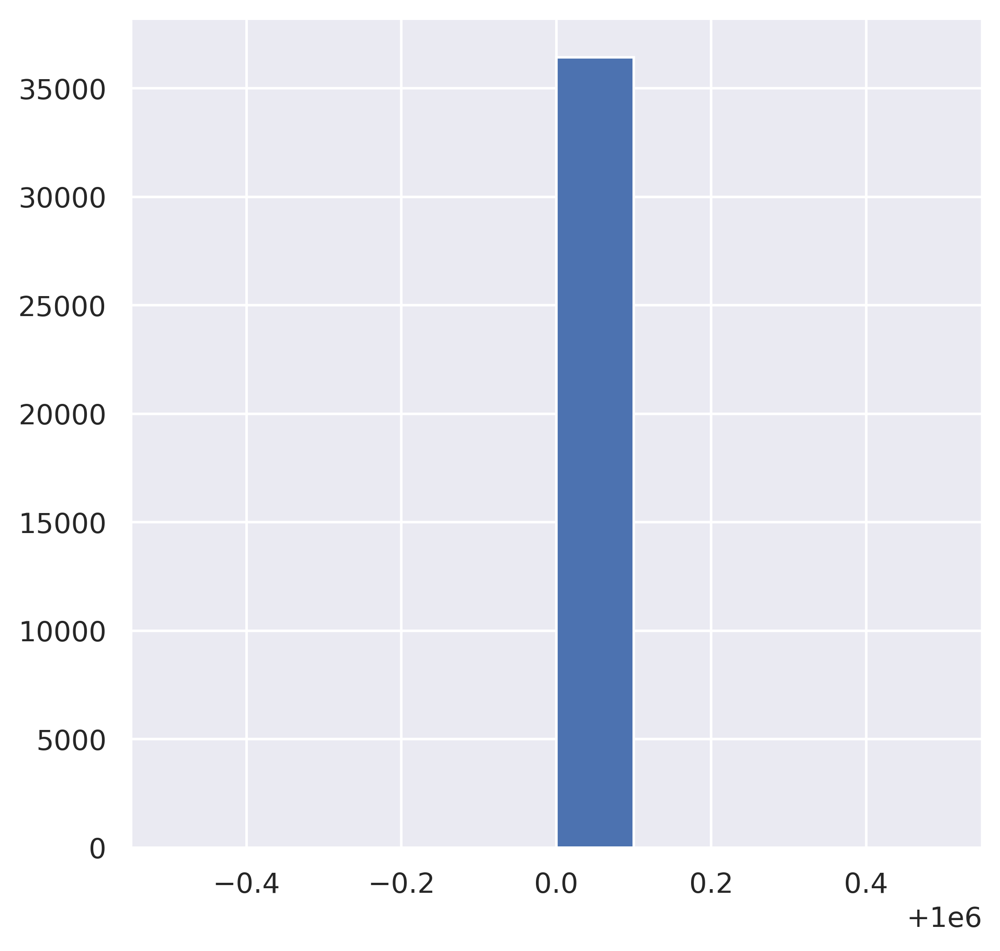

In [6]:

data = all_dataset.X
data = pd.DataFrame( data.todense())  
plt.figure(figsize=(4,6))
print(data.max().max())
ax = plt.hist(data.sum(axis=1))
data = non_log2cpm(exp_df=data)
print(data.max().max())
plt.figure(figsize=(6,6))
plt.hist(np.around(np.array(data.sum(axis=1)),0))



#16498 sample


In [7]:
all_dataset = an.AnnData(data)
all_dataset.X = csr_matrix(all_dataset.X)
all_dataset

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


AnnData object with n_obs × n_vars = 36424 × 25044

In [8]:
all_dataset.var.index = gene_name.index
all_dataset.var.index.name = 'gene_name'
all_dataset.obs = anno
all_dataset.obs = all_dataset.obs.rename(columns ={'sample':'sample_id'})

all_dataset

AnnData object with n_obs × n_vars = 36424 × 25044
    obs: 'sample_id', 'cell_type', 'complexity'

In [9]:
for col in all_dataset.obs.columns:
    all_dataset.obs[col] = all_dataset.obs[col].astype(str)

all_dataset.obs.dtypes

sample_id     object
cell_type     object
complexity    object
dtype: object

In [10]:
all_dataset.var

""
gene_name
RP11-34P13.7
RP11-34P13.8
FO538757.2
AP006222.2
RP4-669L17.10
...
BX072566.1
AL354822.1
AC023491.2


In [11]:

all_dataset.obs

,sample_id,cell_type,complexity
cell_name,,,
GAACCTAAGGTCATCT.1,1,Malignant,2643
TTGACTTTCGGACAAG.1,1,Malignant,2543
ATTACTCAGGAGCGAG.1,1,Malignant,3240
GCAGTTAAGCAGGCTA.1,1,Malignant,3307
GTCGGGTTCCTGTACC.1,1,Malignant,3601
...,...,...,...
ATAAGAGTCACAGGCC.13,13,Mast,2097
ACGAGCCTCATGTGGT.13,13,nan,325
ACAGCTAGTAGCGTGA.13,13,Mast,1501


In [12]:
all_files = list(all_dataset.obs['sample_id'].unique())
print(len(all_files))
print(all_dataset.obs['sample_id'].value_counts())


13
12    5780
2     5302
3     4982
4     4077
8     3032
11    2824
9     2458
6     1586
1     1554
7     1534
5     1339
13    1277
10     679
Name: sample_id, dtype: int64


#----------------------------------------------
Deal with 1...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (1554, 25044)


<Figure size 3000x600 with 0 Axes>

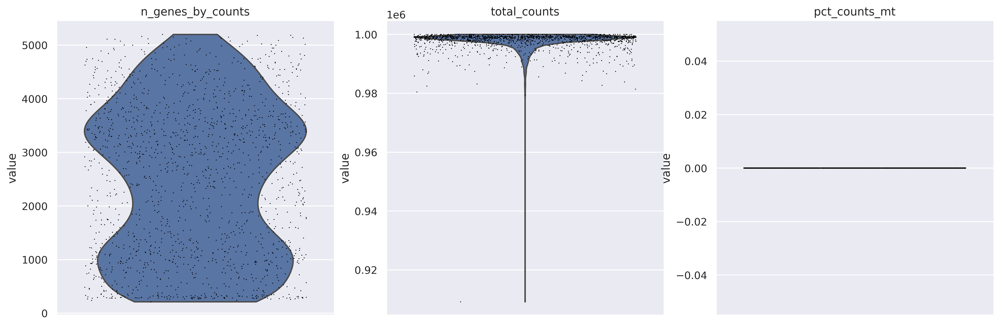

<Figure size 1600x1200 with 0 Axes>

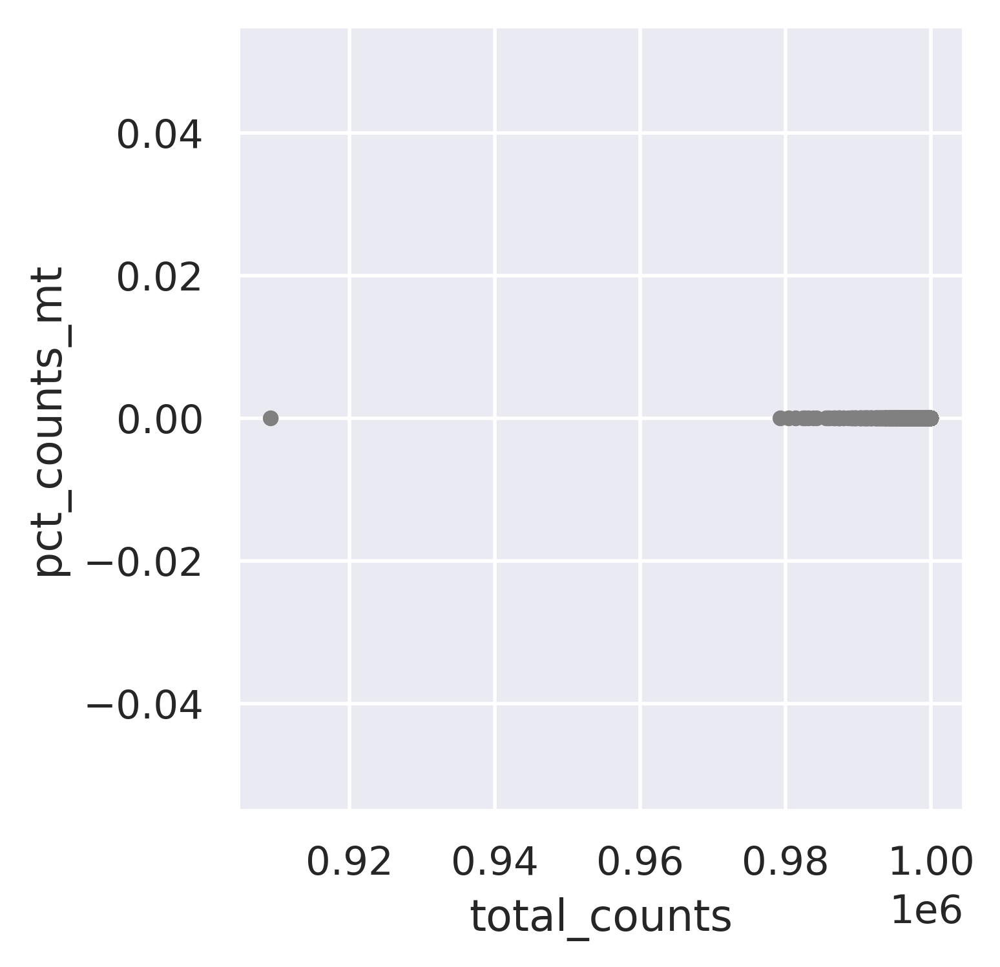

<Figure size 1600x1200 with 0 Axes>

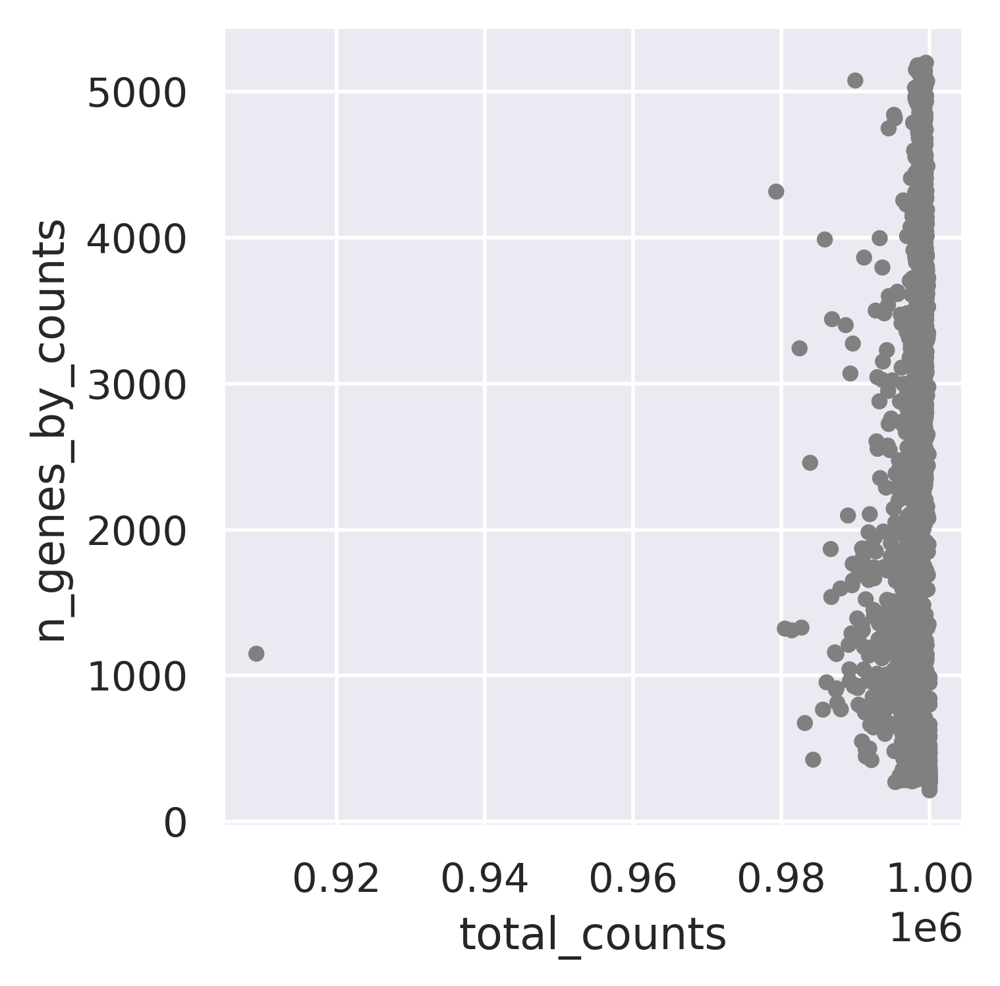

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (1554, 14985)
#----------------------------------------------
Deal with 2...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (5302, 25044)


<Figure size 3000x600 with 0 Axes>

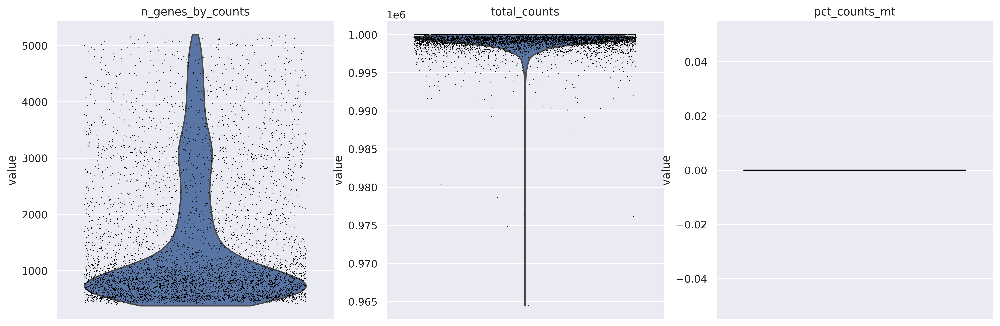

<Figure size 1600x1200 with 0 Axes>

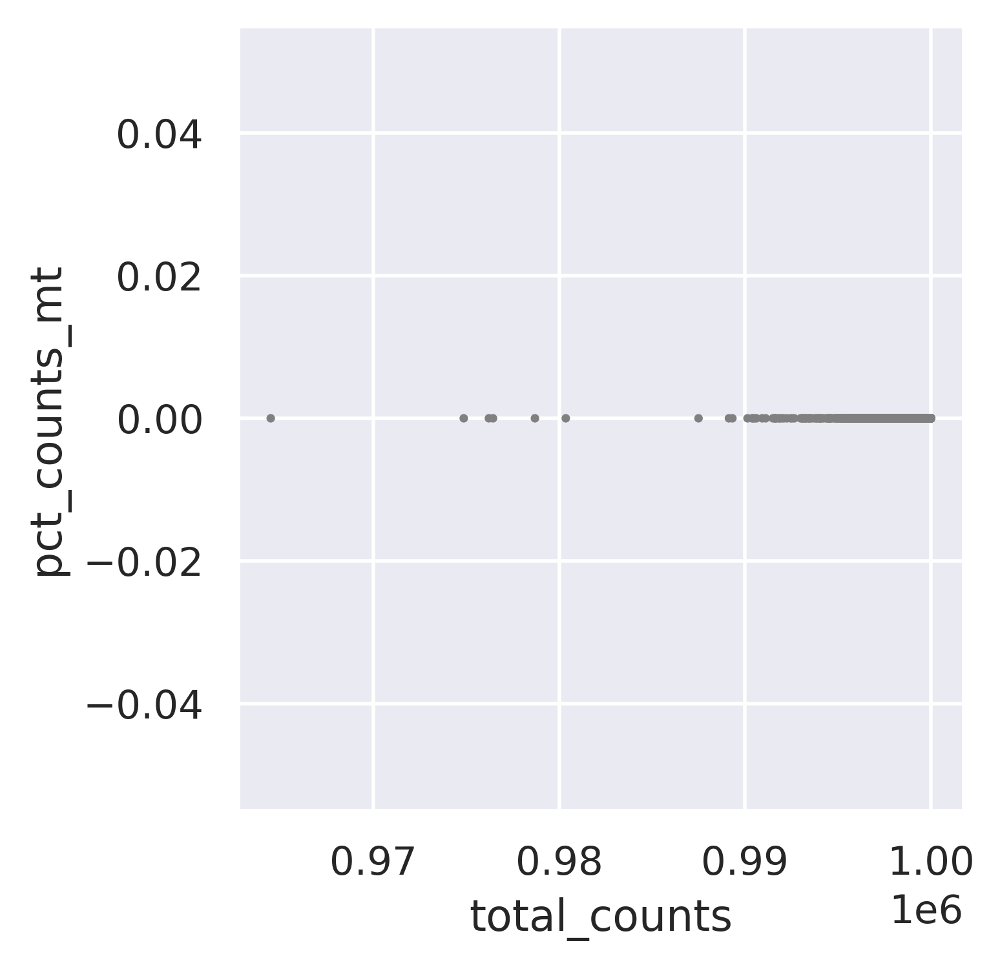

<Figure size 1600x1200 with 0 Axes>

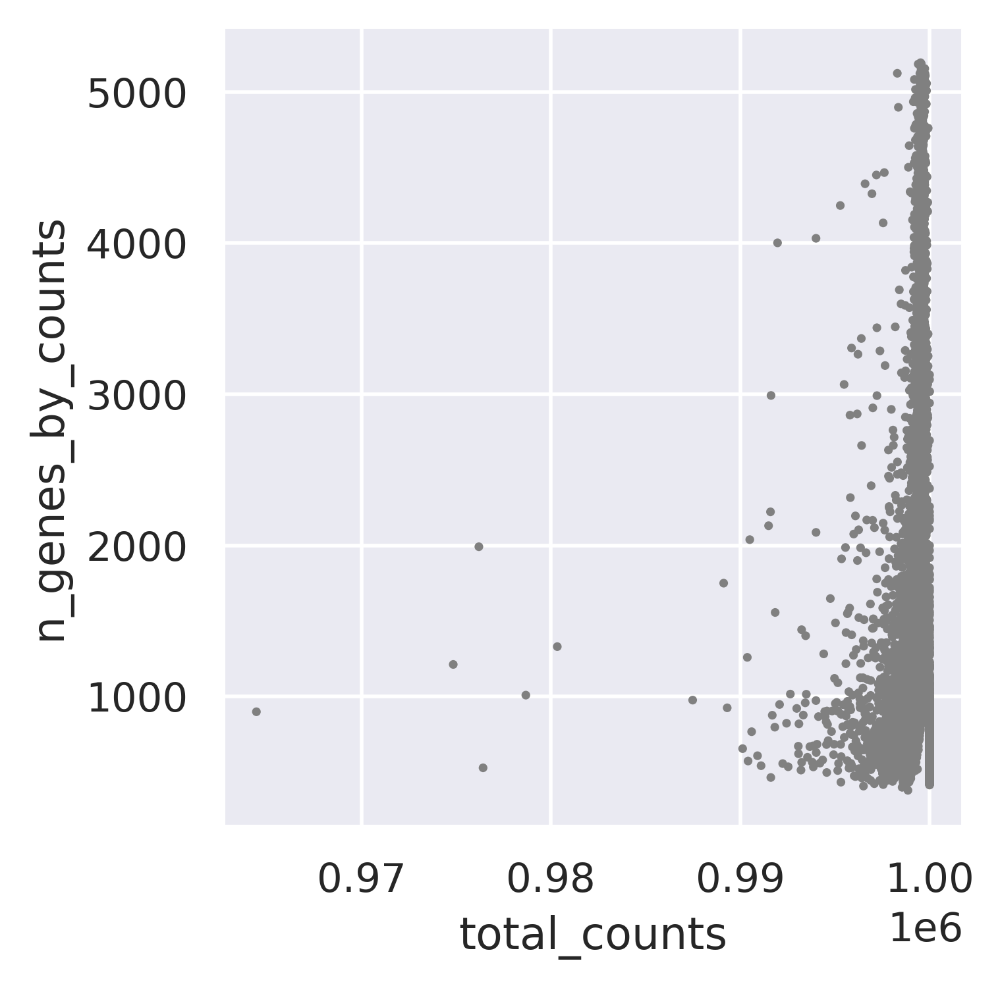

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (5302, 15603)
#----------------------------------------------
Deal with 3...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (4982, 25044)


<Figure size 3000x600 with 0 Axes>

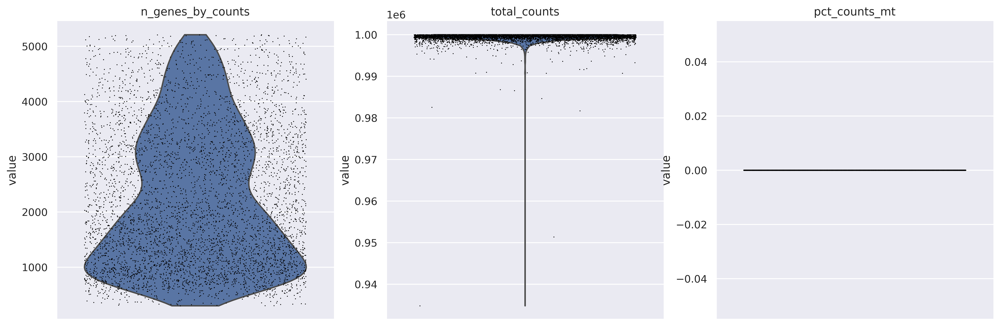

<Figure size 1600x1200 with 0 Axes>

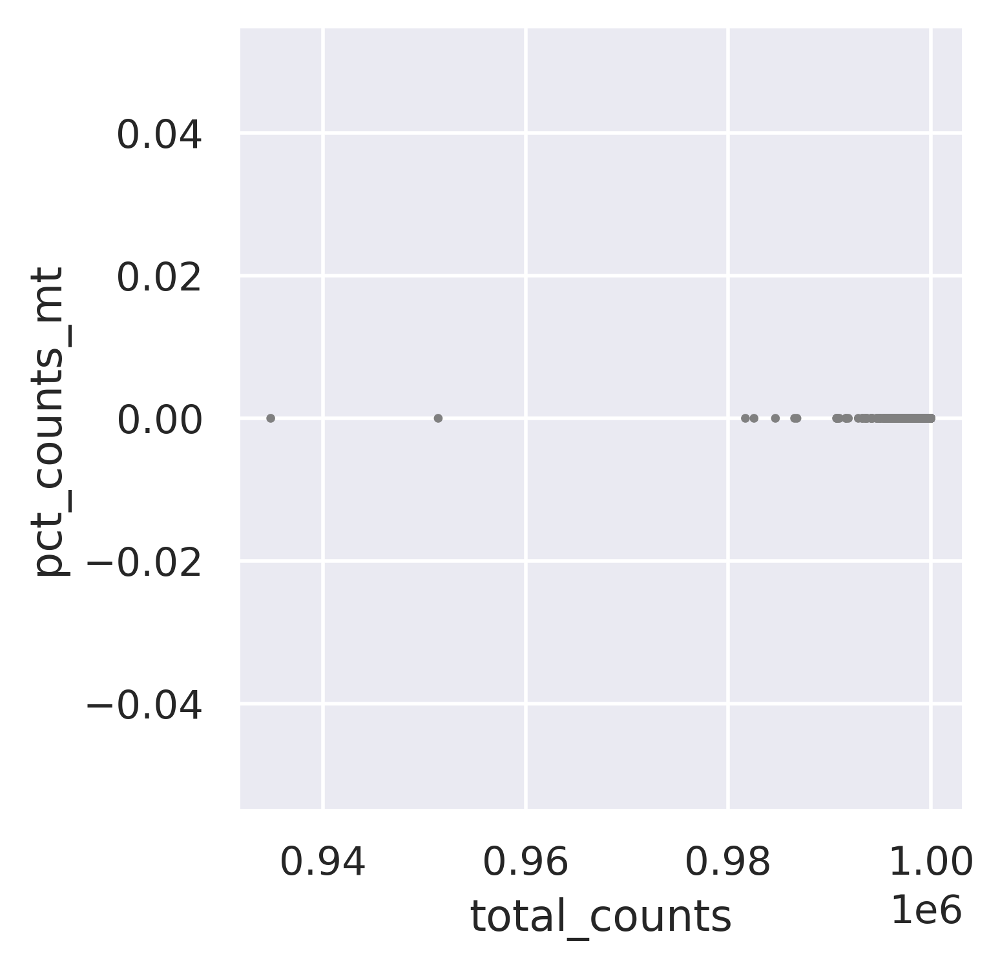

<Figure size 1600x1200 with 0 Axes>

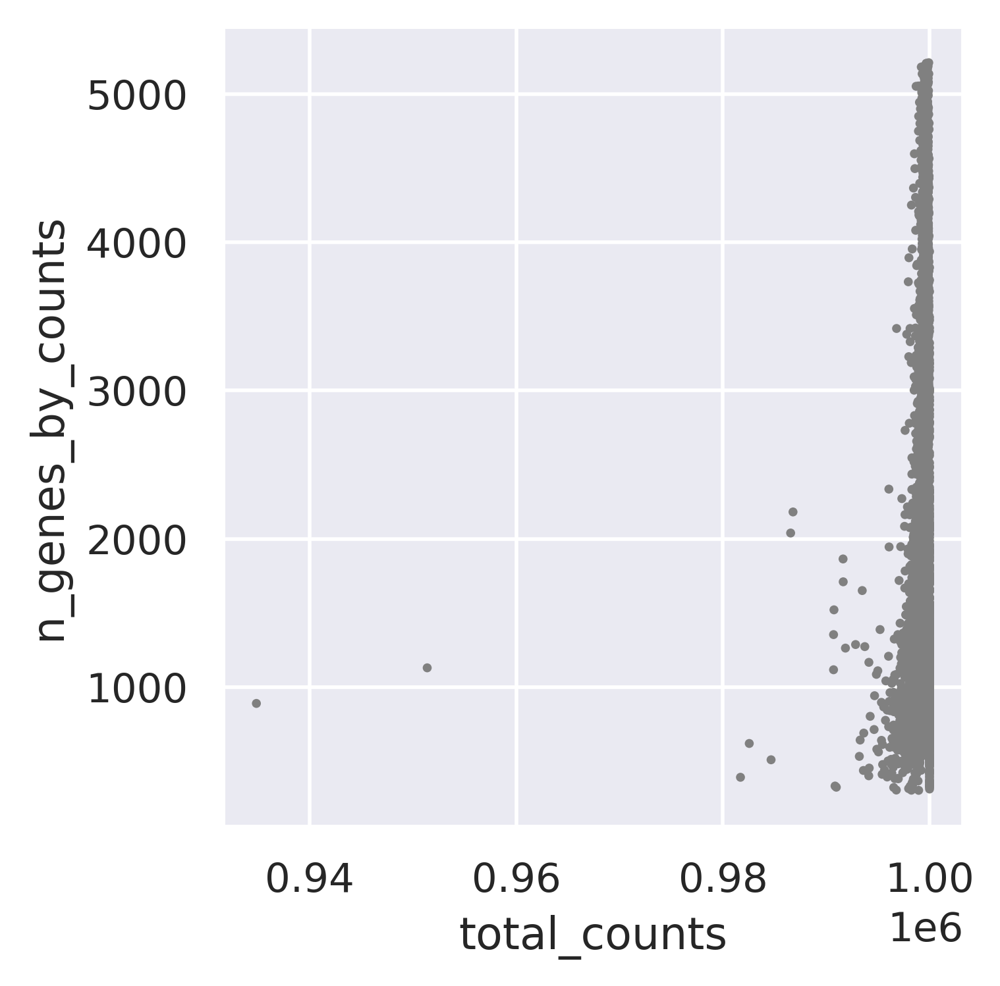

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (4982, 16857)
#----------------------------------------------
Deal with 4...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (4077, 25044)


<Figure size 3000x600 with 0 Axes>

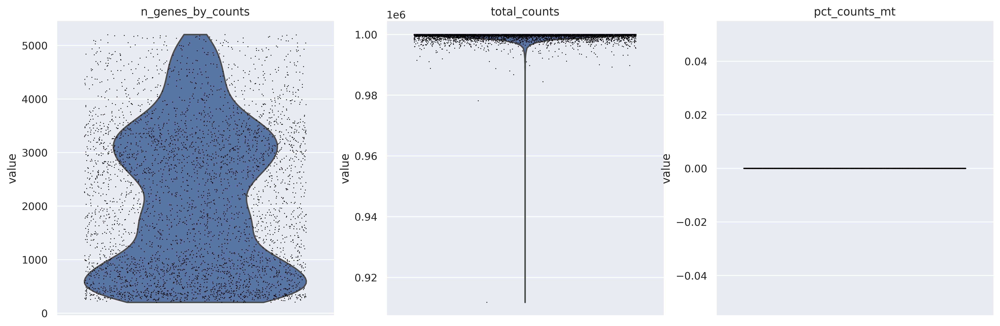

<Figure size 1600x1200 with 0 Axes>

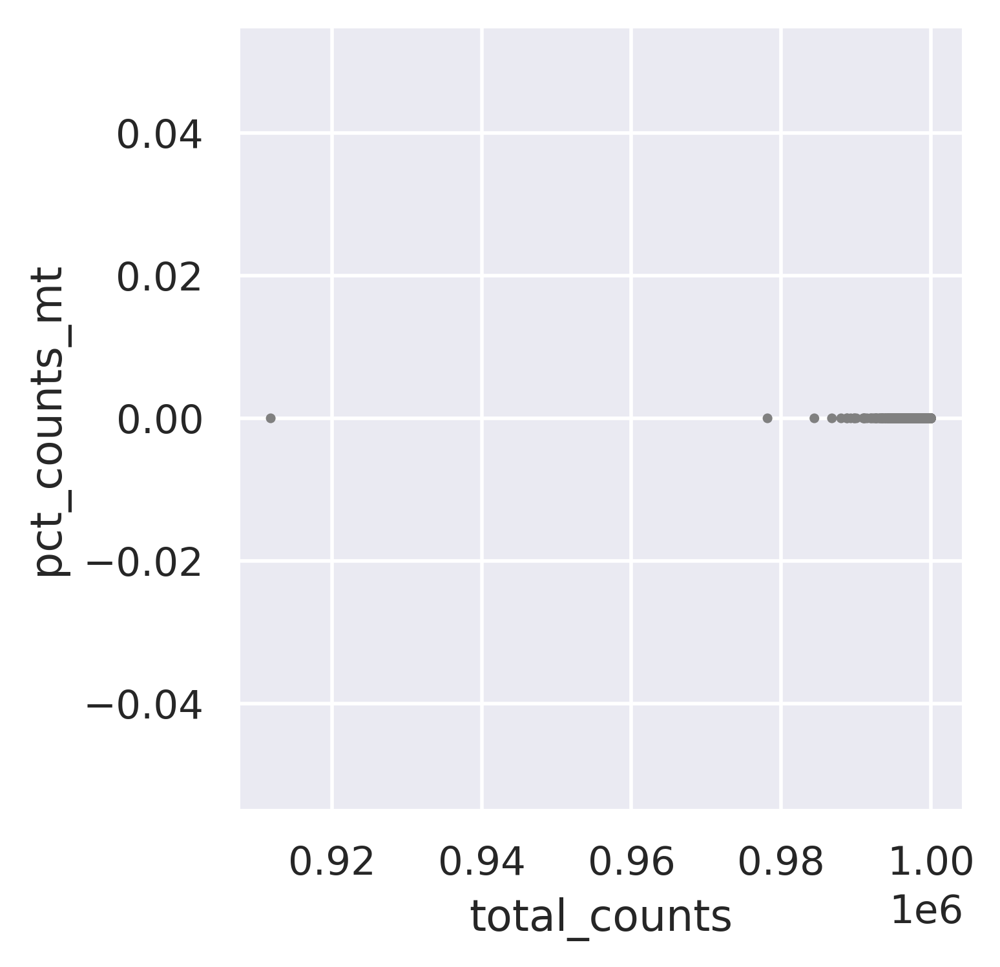

<Figure size 1600x1200 with 0 Axes>

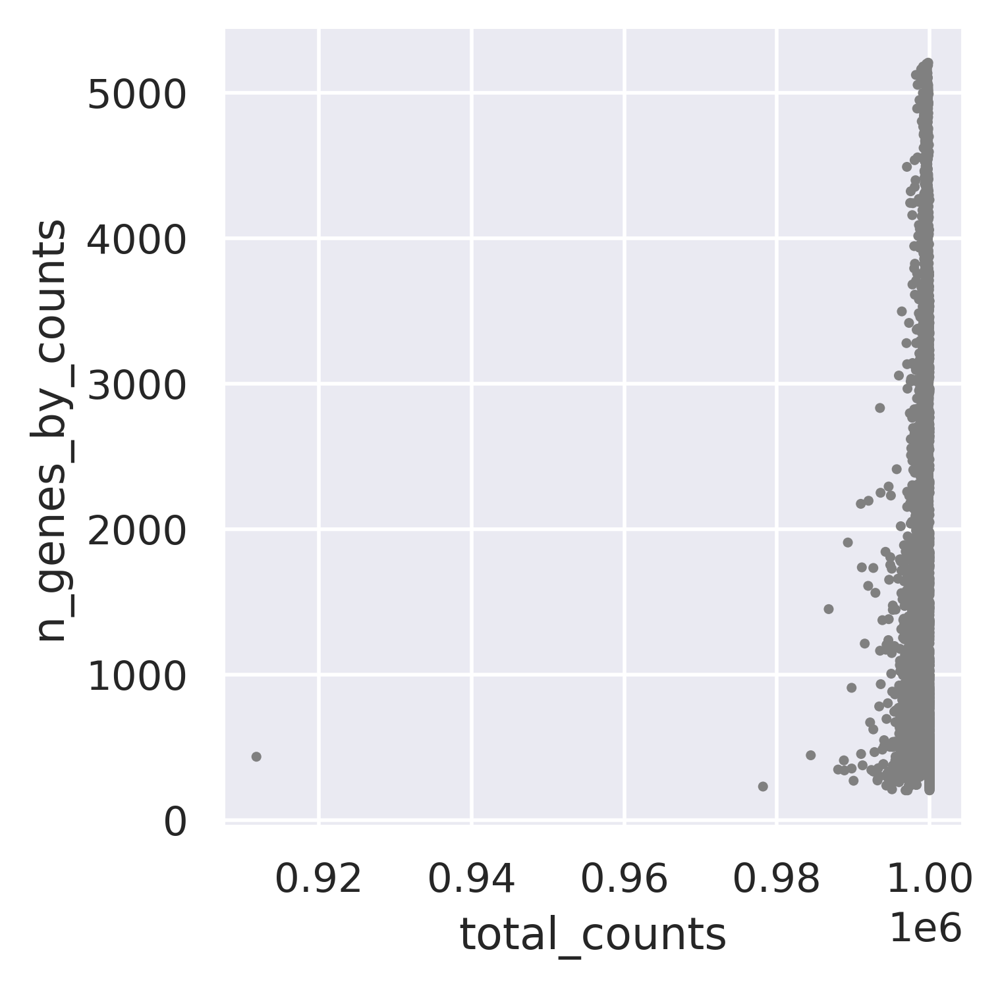

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (4077, 15925)
#----------------------------------------------
Deal with 5...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (1339, 25044)


<Figure size 3000x600 with 0 Axes>

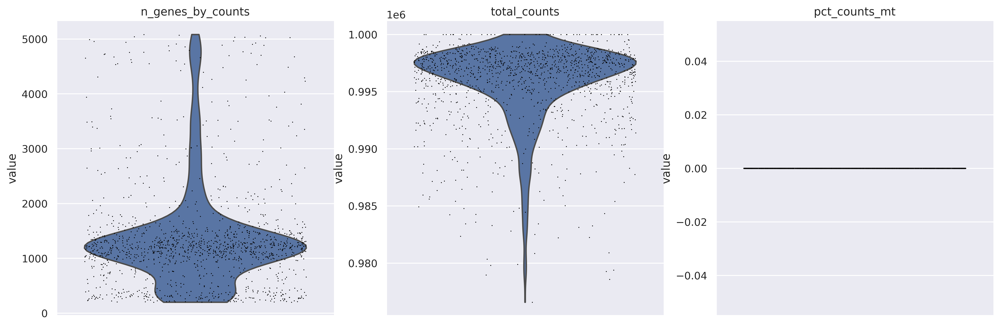

<Figure size 1600x1200 with 0 Axes>

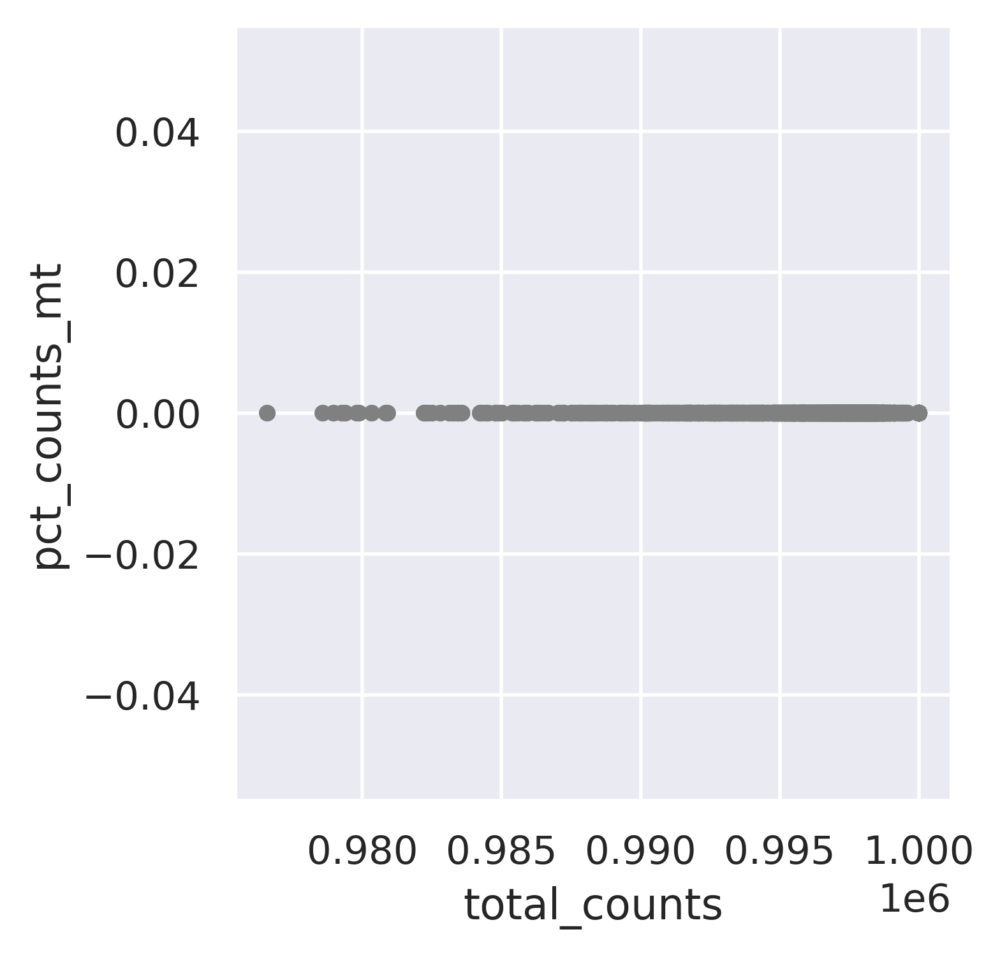

<Figure size 1600x1200 with 0 Axes>

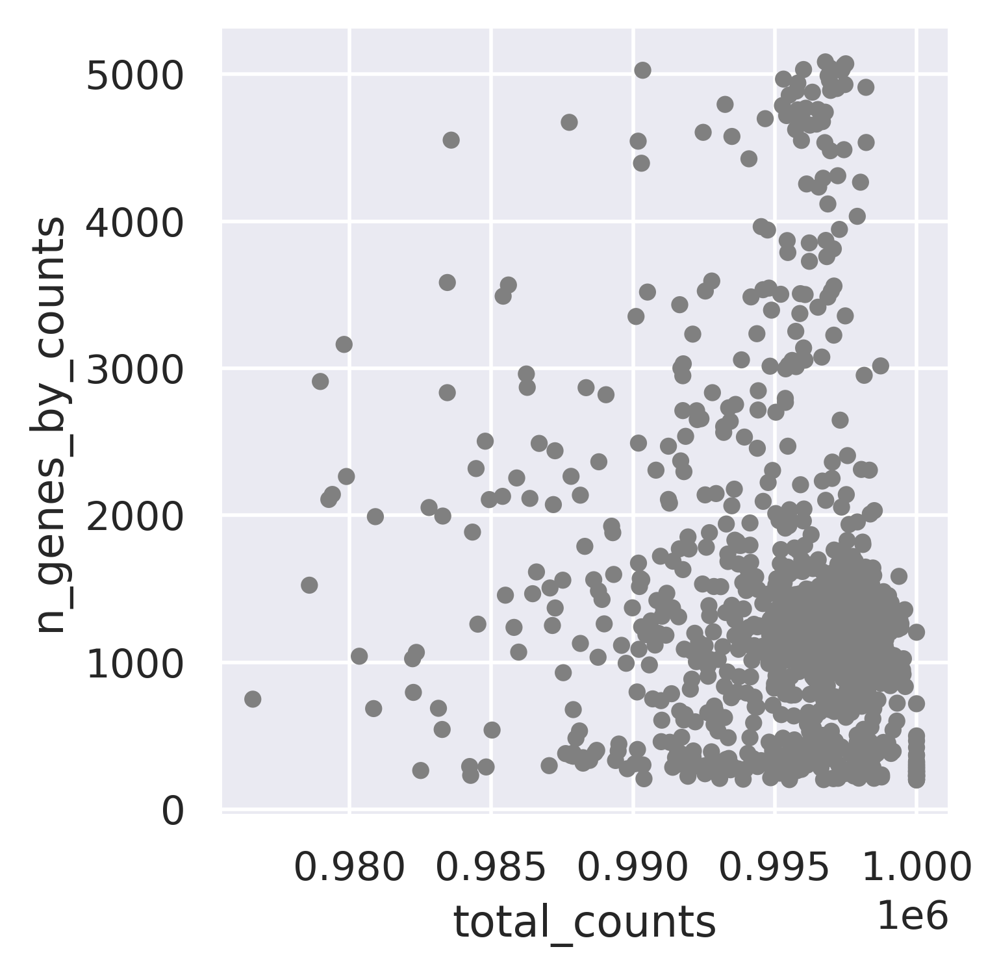

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (1339, 13653)
#----------------------------------------------
Deal with 6...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (1586, 25044)


<Figure size 3000x600 with 0 Axes>

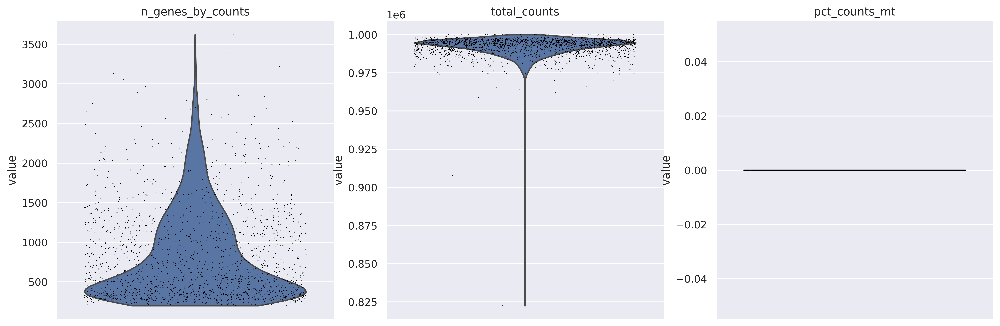

<Figure size 1600x1200 with 0 Axes>

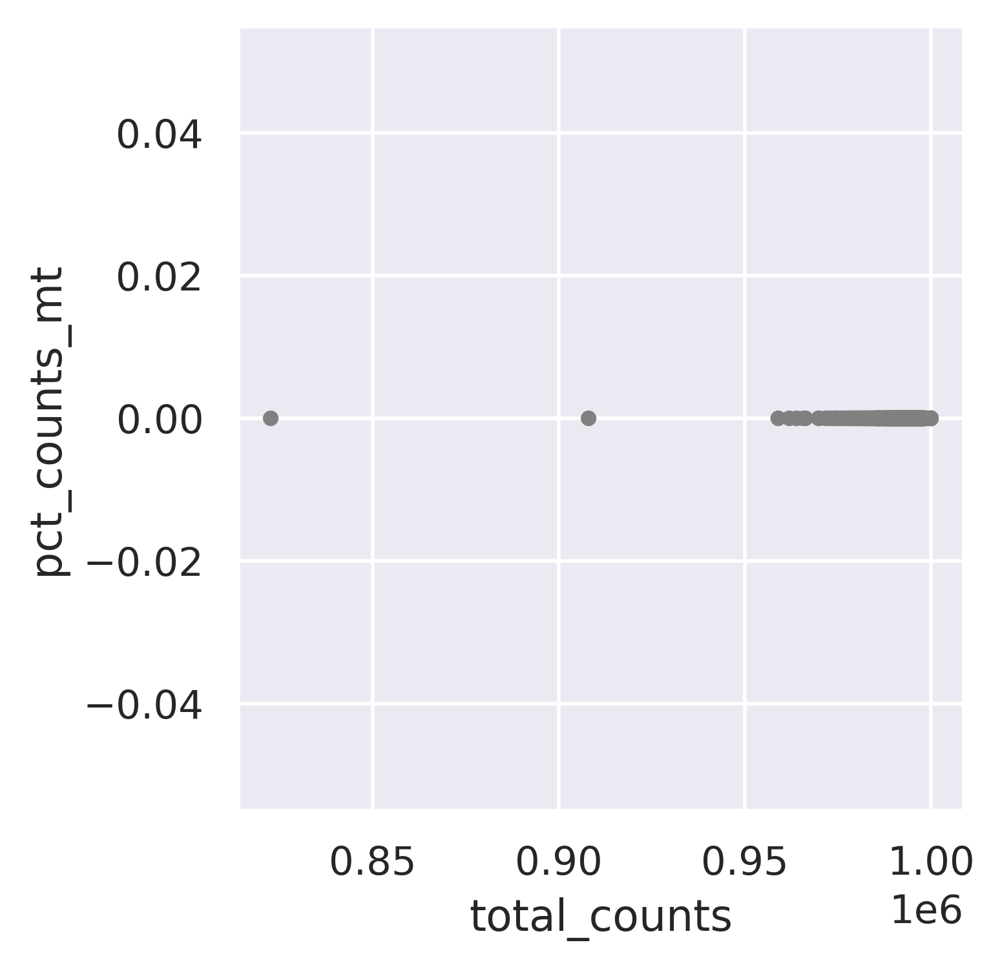

<Figure size 1600x1200 with 0 Axes>

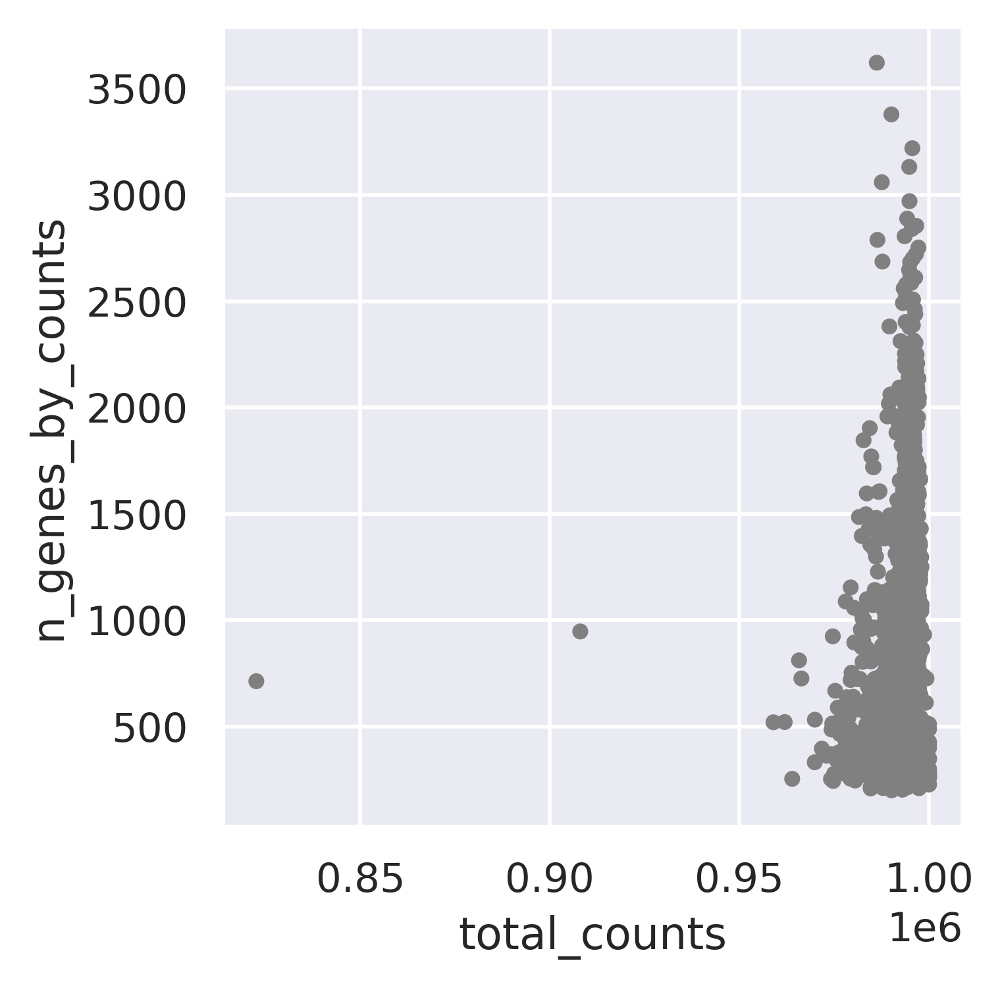

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (1586, 11622)
#----------------------------------------------
Deal with 7...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (1534, 25044)


<Figure size 3000x600 with 0 Axes>

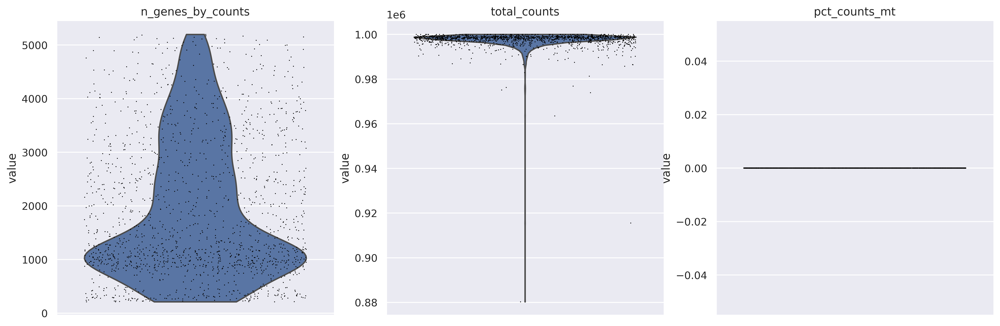

<Figure size 1600x1200 with 0 Axes>

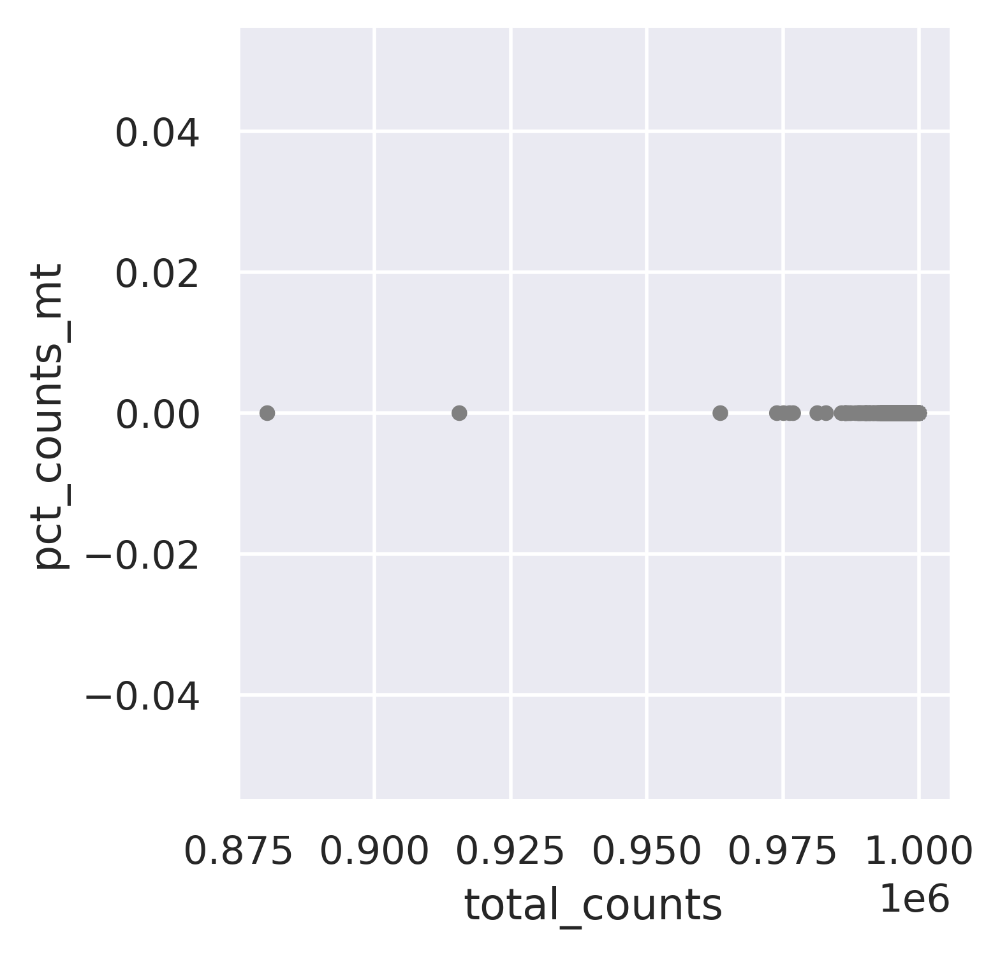

<Figure size 1600x1200 with 0 Axes>

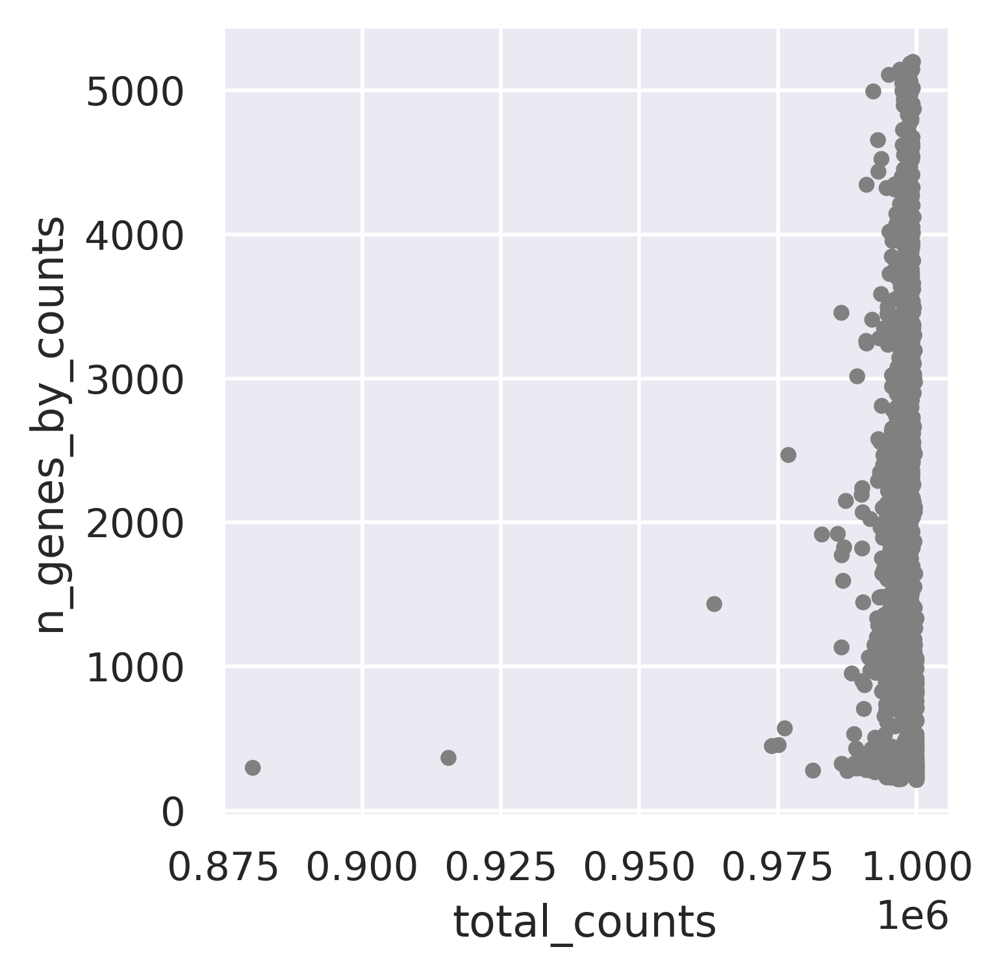

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (1534, 14504)
#----------------------------------------------
Deal with 8...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (3032, 25044)


<Figure size 3000x600 with 0 Axes>

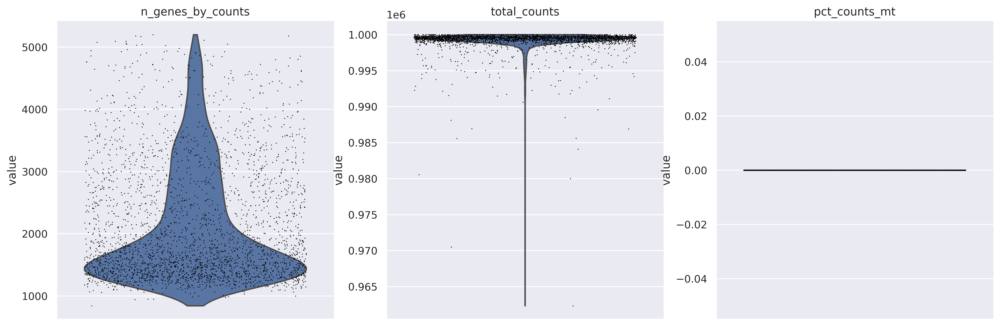

<Figure size 1600x1200 with 0 Axes>

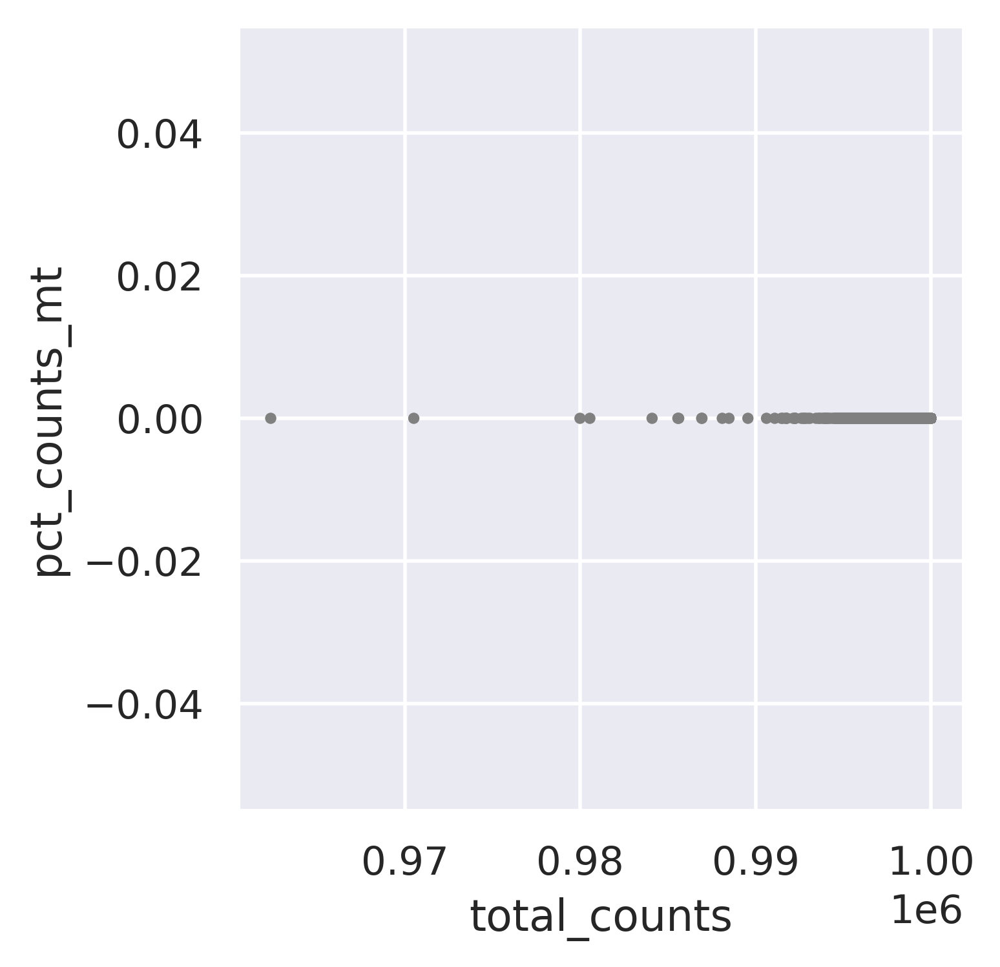

<Figure size 1600x1200 with 0 Axes>

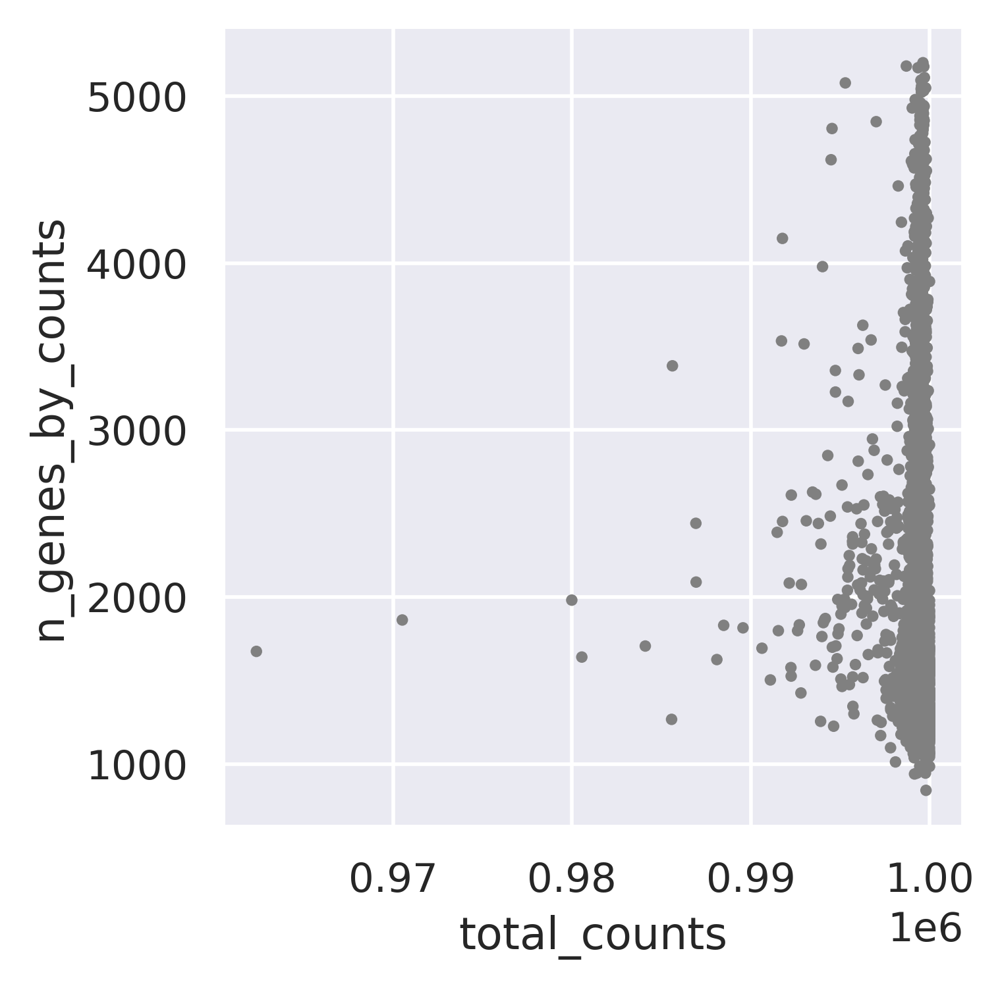

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (3032, 15026)
#----------------------------------------------
Deal with 10...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (679, 25044)


<Figure size 3000x600 with 0 Axes>

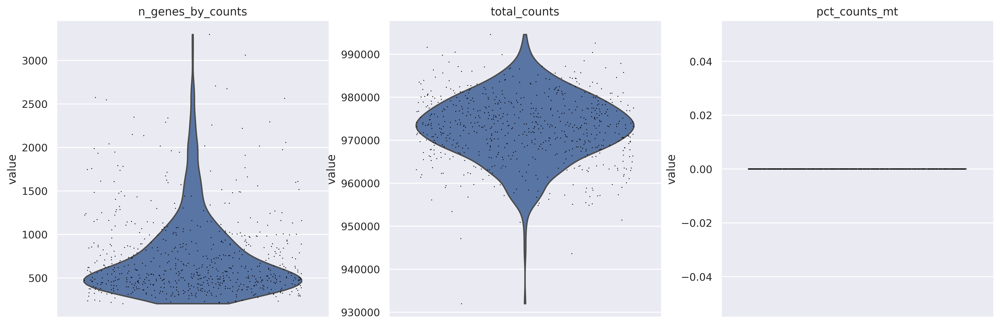

<Figure size 1600x1200 with 0 Axes>

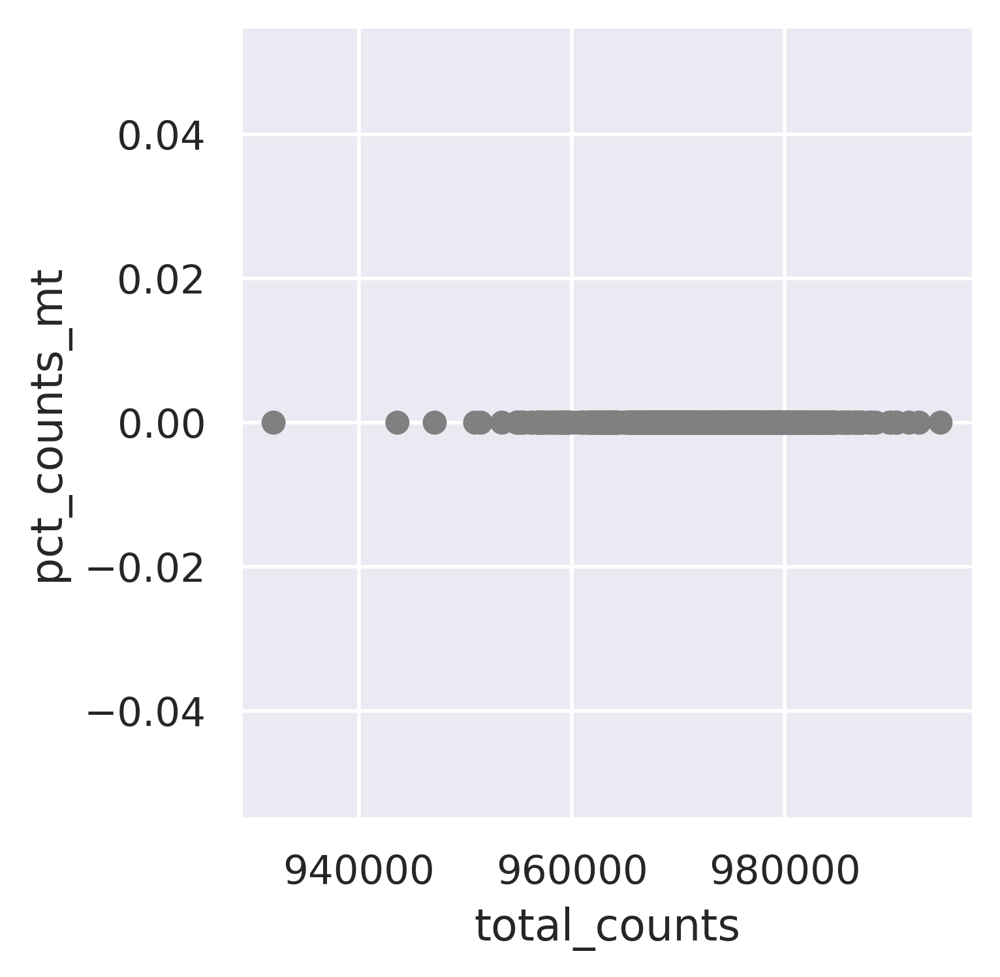

<Figure size 1600x1200 with 0 Axes>

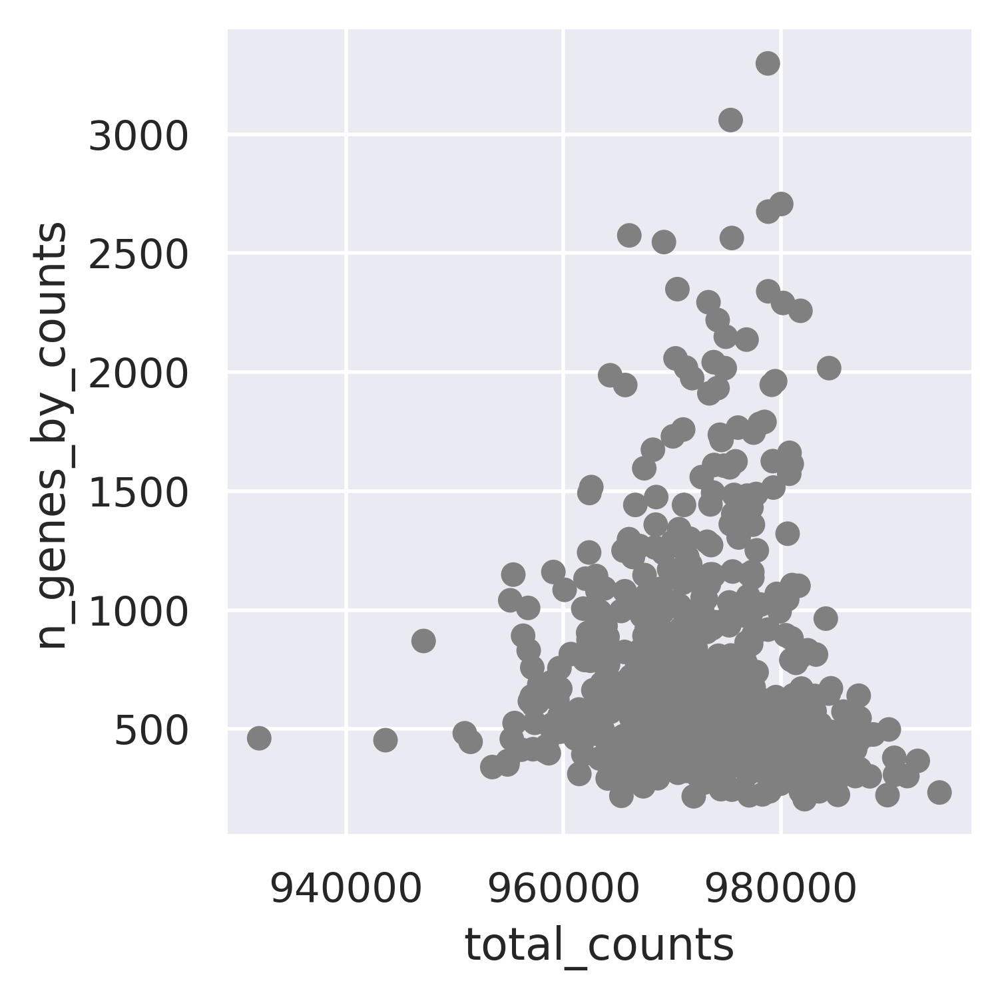

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (679, 8935)
#----------------------------------------------
Deal with 11...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (2824, 25044)


<Figure size 3000x600 with 0 Axes>

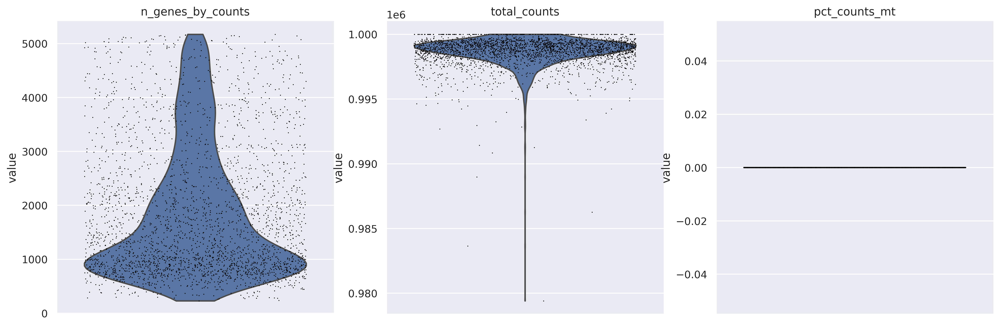

<Figure size 1600x1200 with 0 Axes>

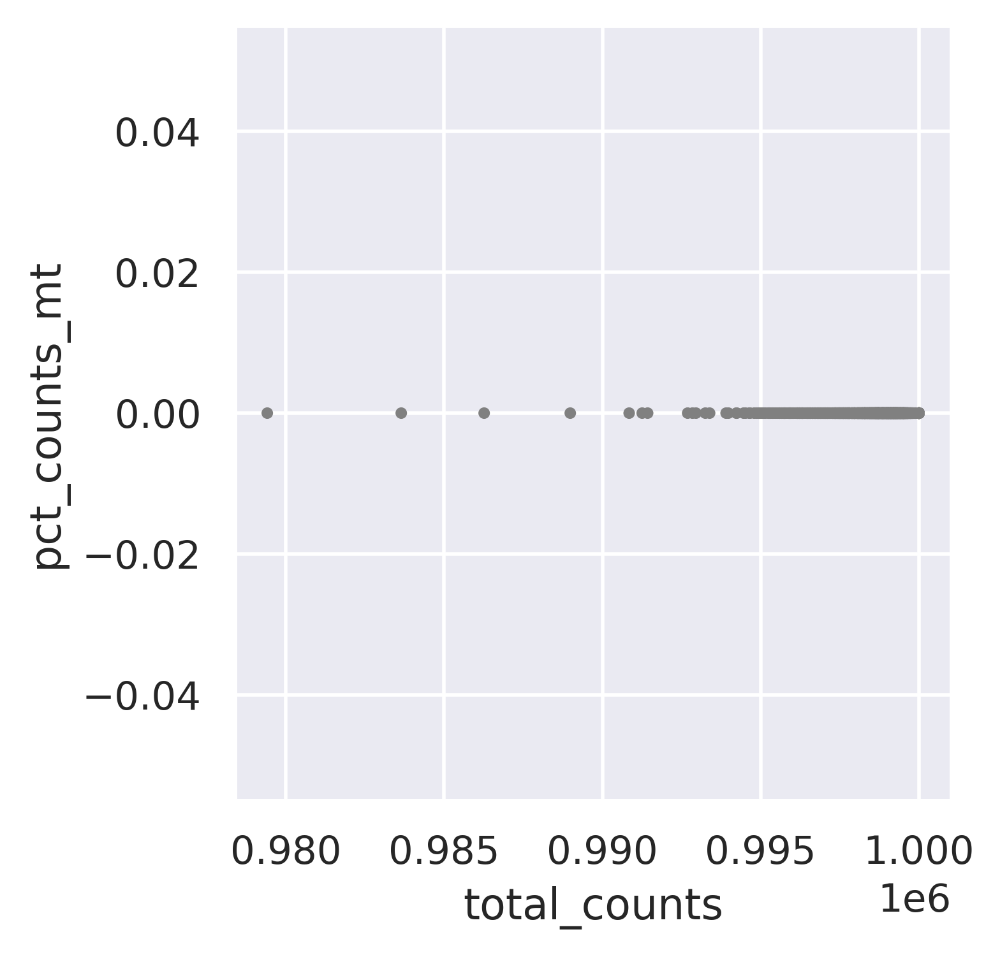

<Figure size 1600x1200 with 0 Axes>

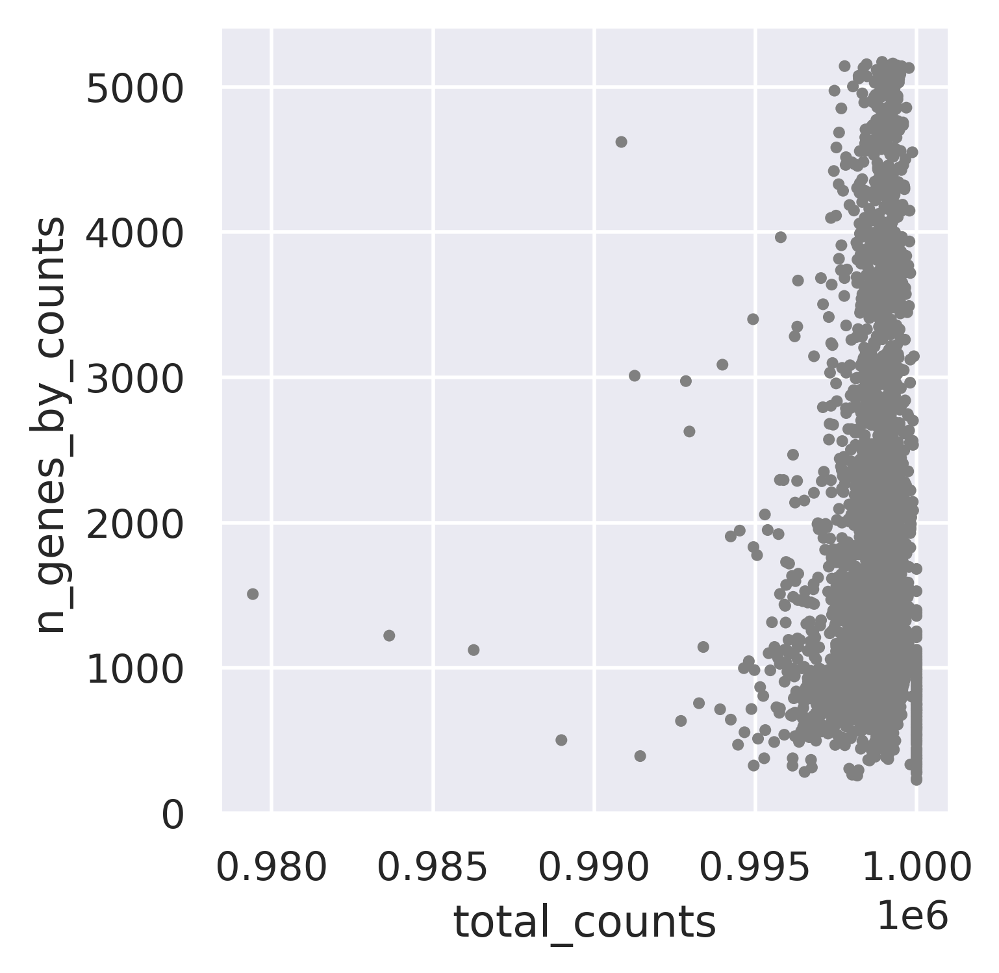

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (2824, 16410)
#----------------------------------------------
Deal with 12...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (5780, 25044)


<Figure size 3000x600 with 0 Axes>

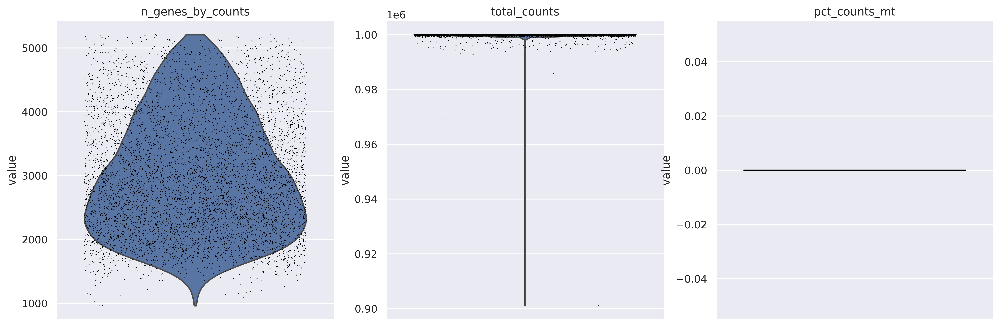

<Figure size 1600x1200 with 0 Axes>

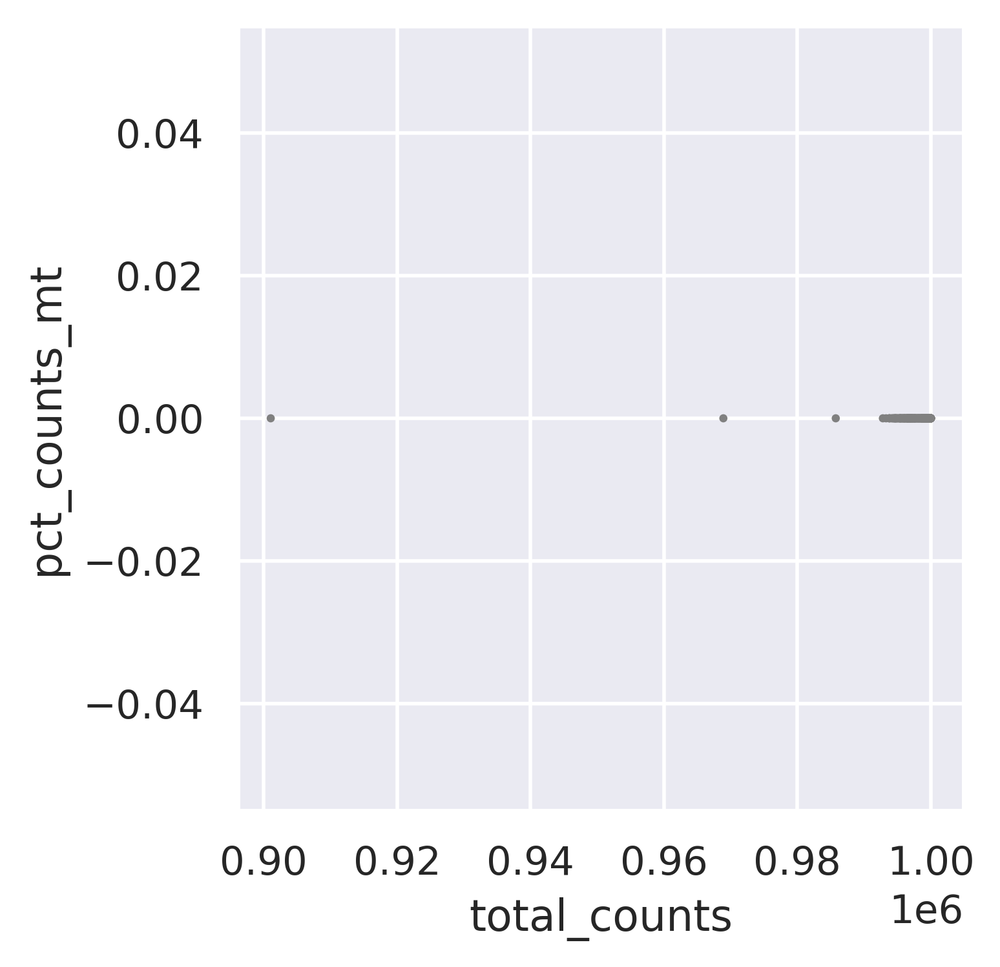

<Figure size 1600x1200 with 0 Axes>

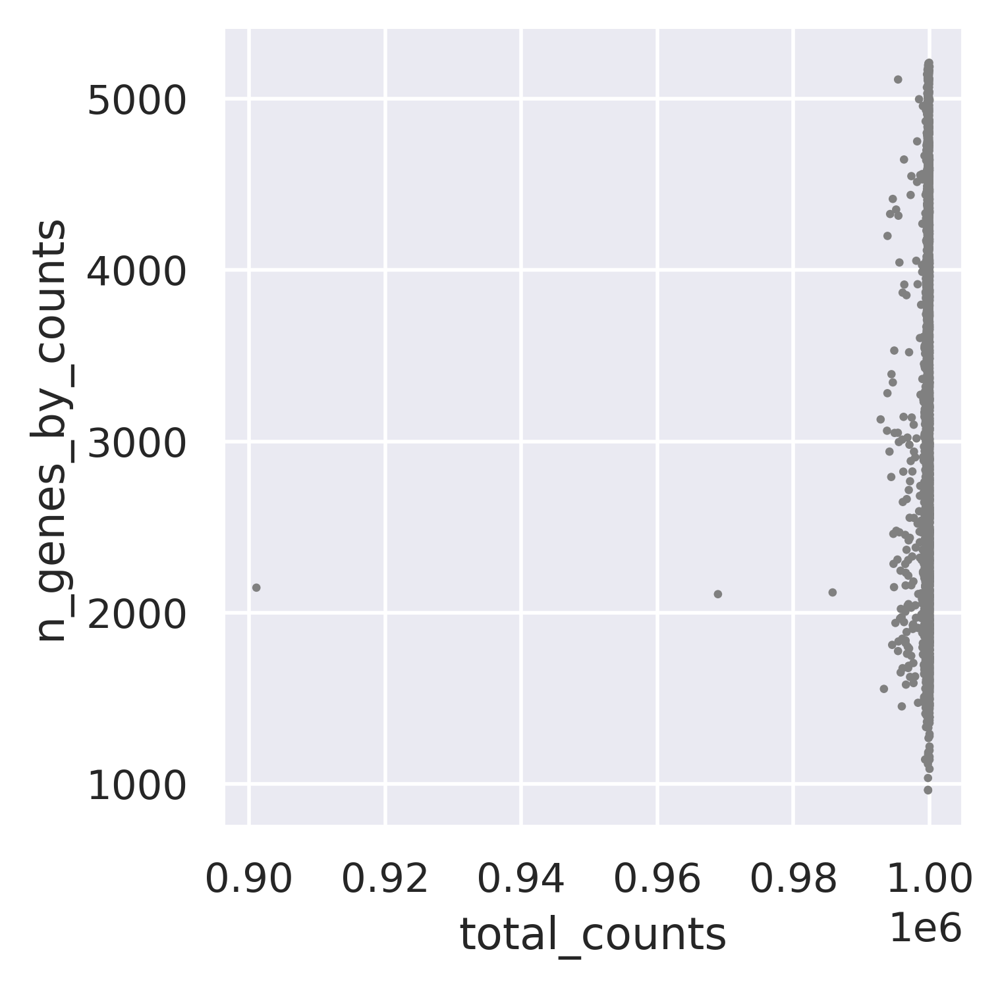

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (5780, 16529)
#----------------------------------------------
Deal with 13...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (1277, 25044)


<Figure size 3000x600 with 0 Axes>

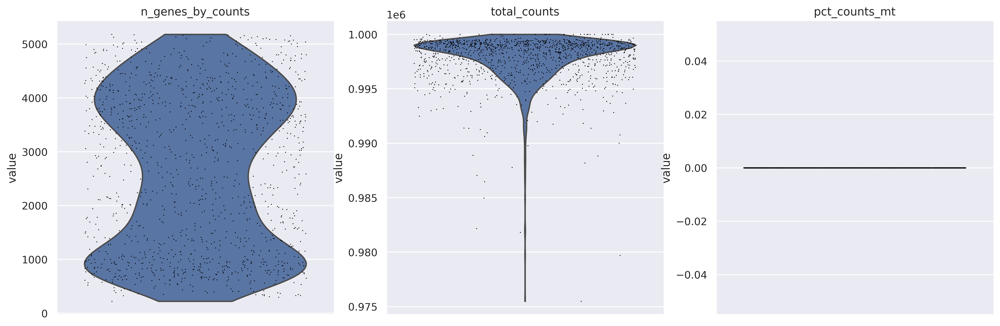

<Figure size 1600x1200 with 0 Axes>

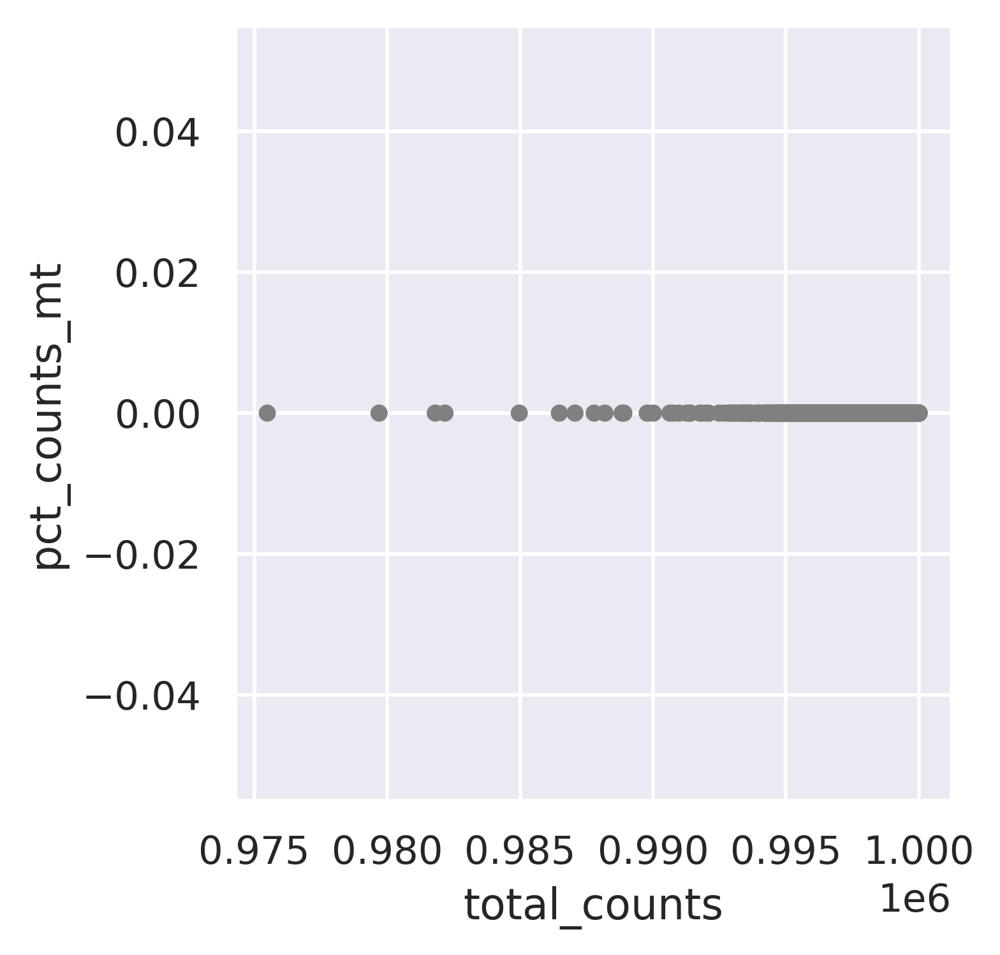

<Figure size 1600x1200 with 0 Axes>

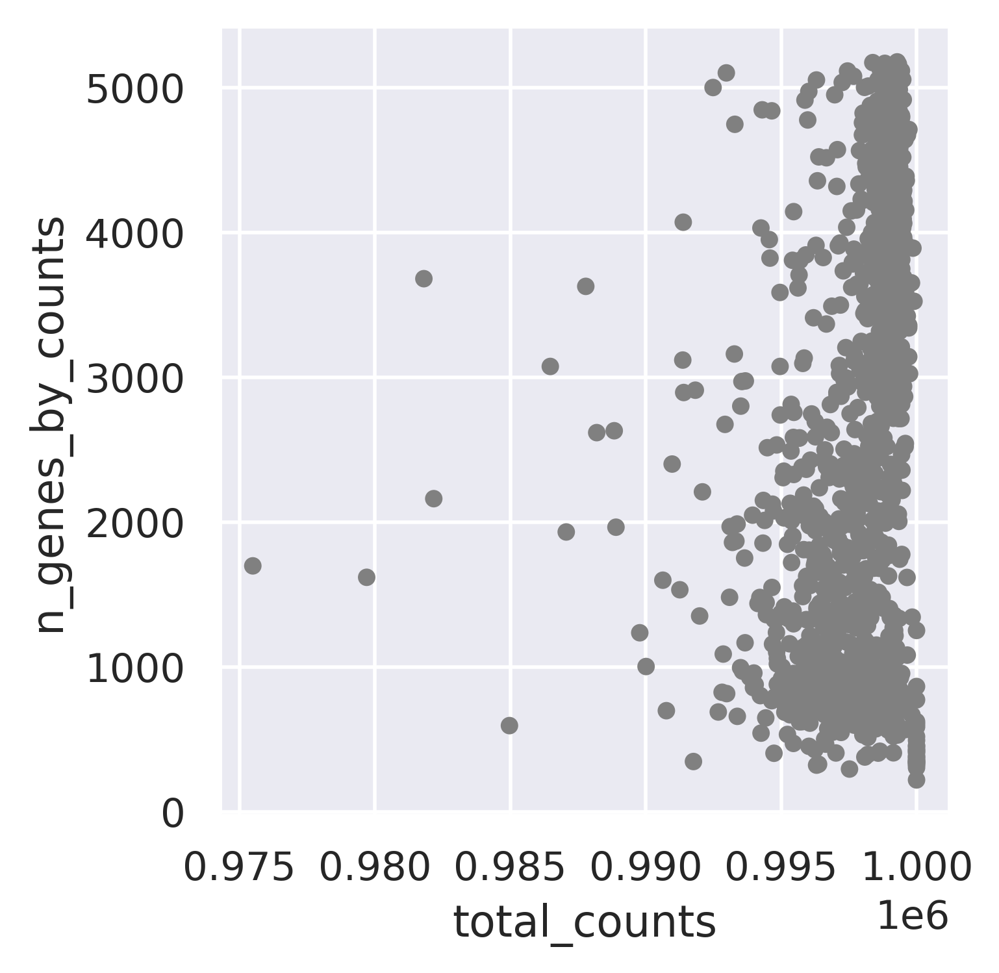

   The shape of adata after filtering is: (1277, 15052)


/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


In [13]:
sample_number_afterfilter = 0
for _file in all_files:
    if _file!='9':   # the sample of 9 is lymph node metastasis tituse
        print('#----------------------------------------------')
        print('Deal with {}...'.format(_file))
        current_sample = all_dataset[all_dataset.obs['sample_id']==_file, :]
        print(type(current_sample.X))
        current_sample_normalized = normalize_mtx(adata=current_sample, result_dir=result_dir, prefix='', fig_prefix=_file, target_sum=1e6,
                                                  max_n_genes_by_counts=8000, max_pct_counts_mt=10, max_total_counts=1e6+100, log_base=2, 
                                                  filter_genes=True, min_cells=10)   
        sample_number_afterfilter += current_sample_normalized.shape[0]
        current_sample_normalized.write(os.path.join(result_dir, _file+'_raw.h5ad'))


In [14]:
print(sample_number_afterfilter)

33966


In [15]:

sample2dataset = {}
for _file in all_files:
    if _file!='9':   # the sample of 9 is lymph node metastasis tituse
        current_file_path = os.path.join(result_dir, _file + '_raw.h5ad')
        current_dataset = sc.read_h5ad(current_file_path, backed=None)
        if current_dataset.shape[0] >= 1:
  
            sample2dataset[_file] = current_dataset
        else:
            print('Remove file {} with shape: {}'.format(_file, current_dataset.shape()))

In [16]:
sample2dataset[_file].obs

,sample_id,cell_type,complexity,n_genes,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt
cell_name,,,,,,,,
CATCAAGGTCGGATCC.13,13,Malignant,3664,3664,3653,9.992159e+05,0.0,0.0
ACTATCTGTCGGCATC.13,13,Malignant,4365,4365,4345,9.987660e+05,0.0,0.0
GGACGTCTCGTAGGAG.13,13,Malignant,4831,4831,4815,9.993845e+05,0.0,0.0
TCGCGTTGTAGCCTAT.13,13,Malignant,3840,3840,3819,9.986498e+05,0.0,0.0
ATAAGAGTCGCGGATC.13,13,Malignant,3985,3985,3959,9.982162e+05,0.0,0.0
...,...,...,...,...,...,...,...,...
ATAAGAGTCACAGGCC.13,13,Mast,2097,2097,2063,9.955302e+05,0.0,0.0
ACGAGCCTCATGTGGT.13,13,nan,325,325,325,1.000000e+06,0.0,0.0
ACAGCTAGTAGCGTGA.13,13,Mast,1501,1501,1483,9.930962e+05,0.0,0.0



2 mergering all samples together
https://anndata.readthedocs.io/en/latest/anndata.AnnData.concatenate.htmlr

In [17]:
len(sample2dataset)

12

In [18]:
all_dataset = None
all_dirs = list(sample2dataset.keys())
count=0
for i in range(len(sample2dataset)-1):
    print('dealing with {}'.format(all_dirs[i]))
    next_dataset = sample2dataset[all_dirs[i+1]]
    count+=1
    if all_dataset is None:
        current_dataset = sample2dataset[all_dirs[i]]
        all_dataset = current_dataset.concatenate(next_dataset, index_unique=None, join='outer')

    else:
        all_dataset = all_dataset.concatenate(next_dataset, index_unique=None, join='outer')


dealing with 1


/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/anndata/_core/anndata.py:1763: FutureWarning: The AnnData.concatenate method is deprecated in favour of the anndata.concat function. Please use anndata.concat instead.

See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  warnings.warn(


dealing with 2
dealing with 3
dealing with 4
dealing with 5
dealing with 6
dealing with 7
dealing with 8
dealing with 10
dealing with 11
dealing with 12


In [19]:
all_dataset

AnnData object with n_obs × n_vars = 33966 × 19316
    obs: 'sample_id', 'cell_type', 'complexity', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch'
    var: 'n_cells-0-0-0-0-0-0-0-0-0-0-0', 'mt-0-0-0-0-0-0-0-0-0-0-0', 'n_cells_by_counts-0-0-0-0-0-0-0-0-0-0-0', 'mean_counts-0-0-0-0-0-0-0-0-0-0-0', 'pct_dropout_by_counts-0-0-0-0-0-0-0-0-0-0-0', 'total_counts-0-0-0-0-0-0-0-0-0-0-0', 'n_cells-1-0-0-0-0-0-0-0-0-0-0', 'mt-1-0-0-0-0-0-0-0-0-0-0', 'n_cells_by_counts-1-0-0-0-0-0-0-0-0-0-0', 'mean_counts-1-0-0-0-0-0-0-0-0-0-0', 'pct_dropout_by_counts-1-0-0-0-0-0-0-0-0-0-0', 'total_counts-1-0-0-0-0-0-0-0-0-0-0', 'n_cells-1-0-0-0-0-0-0-0-0-0', 'mt-1-0-0-0-0-0-0-0-0-0', 'n_cells_by_counts-1-0-0-0-0-0-0-0-0-0', 'mean_counts-1-0-0-0-0-0-0-0-0-0', 'pct_dropout_by_counts-1-0-0-0-0-0-0-0-0-0', 'total_counts-1-0-0-0-0-0-0-0-0-0', 'n_cells-1-0-0-0-0-0-0-0-0', 'mt-1-0-0-0-0-0-0-0-0', 'n_cells_by_counts-1-0-0-0-0-0-0-0-0', 'mean_counts-1-0-0-0-0-0-0-0-0', 'pct_dro

In [20]:
print(all_dataset.shape)
all_dataset.obs

(33966, 19316)


,sample_id,cell_type,complexity,n_genes,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,batch
cell_name,,,,,,,,,
GAACCTAAGGTCATCT.1,1,Malignant,2643,2643,2640,9.996289e+05,0.0,0.0,0
TTGACTTTCGGACAAG.1,1,Malignant,2543,2543,2535,9.991533e+05,0.0,0.0,0
ATTACTCAGGAGCGAG.1,1,Malignant,3240,3240,3228,9.990739e+05,0.0,0.0,0
GCAGTTAAGCAGGCTA.1,1,Malignant,3307,3307,3298,9.991721e+05,0.0,0.0,0
GTCGGGTTCCTGTACC.1,1,Malignant,3601,3601,3594,9.996291e+05,0.0,0.0,0
...,...,...,...,...,...,...,...,...,...
ATAAGAGTCACAGGCC.13,13,Mast,2097,2097,2063,9.955302e+05,0.0,0.0,1
ACGAGCCTCATGTGGT.13,13,nan,325,325,325,1.000000e+06,0.0,0.0,1
ACAGCTAGTAGCGTGA.13,13,Mast,1501,1501,1483,9.930962e+05,0.0,0.0,1


In [21]:
all_dataset.var.head(2)

,n_cells-0-0-0-0-0-0-0-0-0-0-0,mt-0-0-0-0-0-0-0-0-0-0-0,n_cells_by_counts-0-0-0-0-0-0-0-0-0-0-0,mean_counts-0-0-0-0-0-0-0-0-0-0-0,pct_dropout_by_counts-0-0-0-0-0-0-0-0-0-0-0,total_counts-0-0-0-0-0-0-0-0-0-0-0,n_cells-1-0-0-0-0-0-0-0-0-0-0,mt-1-0-0-0-0-0-0-0-0-0-0,n_cells_by_counts-1-0-0-0-0-0-0-0-0-0-0,mean_counts-1-0-0-0-0-0-0-0-0-0-0,...,n_cells_by_counts-1-0,mean_counts-1-0,pct_dropout_by_counts-1-0,total_counts-1-0,n_cells-1,mt-1,n_cells_by_counts-1,mean_counts-1,pct_dropout_by_counts-1,total_counts-1
gene_name,,,,,,,,,,,,,,,,,,,,,
A1BG,31.0,False,31.0,4.737679,98.005148,7362.352489,252.0,False,252.0,21.876220,...,68.0,1.381431,98.823529,7984.672215,104.0,False,104.0,18.179095,91.855912,23214.704464
A1BG-AS1,NaN,NaN,NaN,NaN,NaN,NaN,25.0,False,25.0,1.570189,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [22]:
all_dataset.var.drop(columns=all_dataset.var.columns.to_list()[1:-1], inplace=True)
all_dataset.var = all_dataset.var.rename(columns={'n_cells-0-0-0-0-0-0-0-0-0-0-0': 'n_cells'})
all_dataset.var.head(2), all_dataset.var.shape

(           n_cells  total_counts-1
 gene_name                         
 A1BG          31.0    23214.704464
 A1BG-AS1       NaN             NaN,
 (19316, 2))

In [23]:
all_dataset.write(os.path.join(result_dir, f'{data_set_name}.h5ad'))

#### Filter genes by annotation file
- only keep `protein_coding` genes

In [24]:
all_dataset = sc.read_h5ad(os.path.join(result_dir, f'{data_set_name}.h5ad'))


In [25]:
gene_list_in_bulk = pd.read_csv(r'../data/3CA/gencode.gene.info.v22.tsv', index_col=0, sep='\t')
gene_list_in_bulk = gene_list_in_bulk.loc[gene_list_in_bulk['gene_type'] == 'protein_coding', :].copy()
print(gene_list_in_bulk.shape)
gene_list_in_bulk.head(2)

(19814, 11)


,gene_name,seqname,start,end,strand,gene_type,gene_status,havana_gene,full_length,exon_length,exon_num
gene_id,,,,,,,,,,,
ENSG00000206557.5,TRIM71,chr3,32818018,32897826,+,protein_coding,KNOWN,OTTHUMG00000155778.3,79809,8685,4
ENSG00000183813.6,CCR4,chr3,32951574,32956349,+,protein_coding,KNOWN,OTTHUMG00000130752.2,4776,3095,2


In [26]:
common_marker_gene = pd.read_csv('../data/3CA/selected_marker_genes.csv', index_col=0)
print(common_marker_gene.shape)
common_marker_gene.head(2)

(178, 6)


,cell_type,subset,PMID,comment,core_marker,corr_mean
marker_gene,,,,,,
PRSS1,Acinar,Acinar,31273297,pdac_pengj_02,NaN,NaN
PRSS1,Acinar cells,Acinar cells,"Steele, N.G. et al., Nat Cancer, 1097-1112, 2020",pdac_steele_04,NaN,NaN


In [27]:
len(set(all_dataset.var.index) & set(gene_list_in_bulk['gene_name'])), len(set(all_dataset.var.index) & set(common_marker_gene.index)), gene_list_in_bulk.shape, all_dataset.var.shape

(15393, 165, (19814, 11), (19316, 2))

In [28]:
# genes in bulk gene list or marker genes
bulk_marker = set(gene_list_in_bulk['gene_name']) | set(common_marker_gene.index)
len(bulk_marker)

19714

In [29]:
all_dataset = all_dataset[:, all_dataset.var.index.isin(bulk_marker)]
all_dataset

View of AnnData object with n_obs × n_vars = 33966 × 15395
    obs: 'sample_id', 'cell_type', 'complexity', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch'
    var: 'n_cells', 'total_counts-1'

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


19.119


AnnData object with n_obs × n_vars = 33966 × 15395
    obs: 'sample_id', 'cell_type', 'complexity', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch'
    var: 'n_cells', 'total_counts-1'

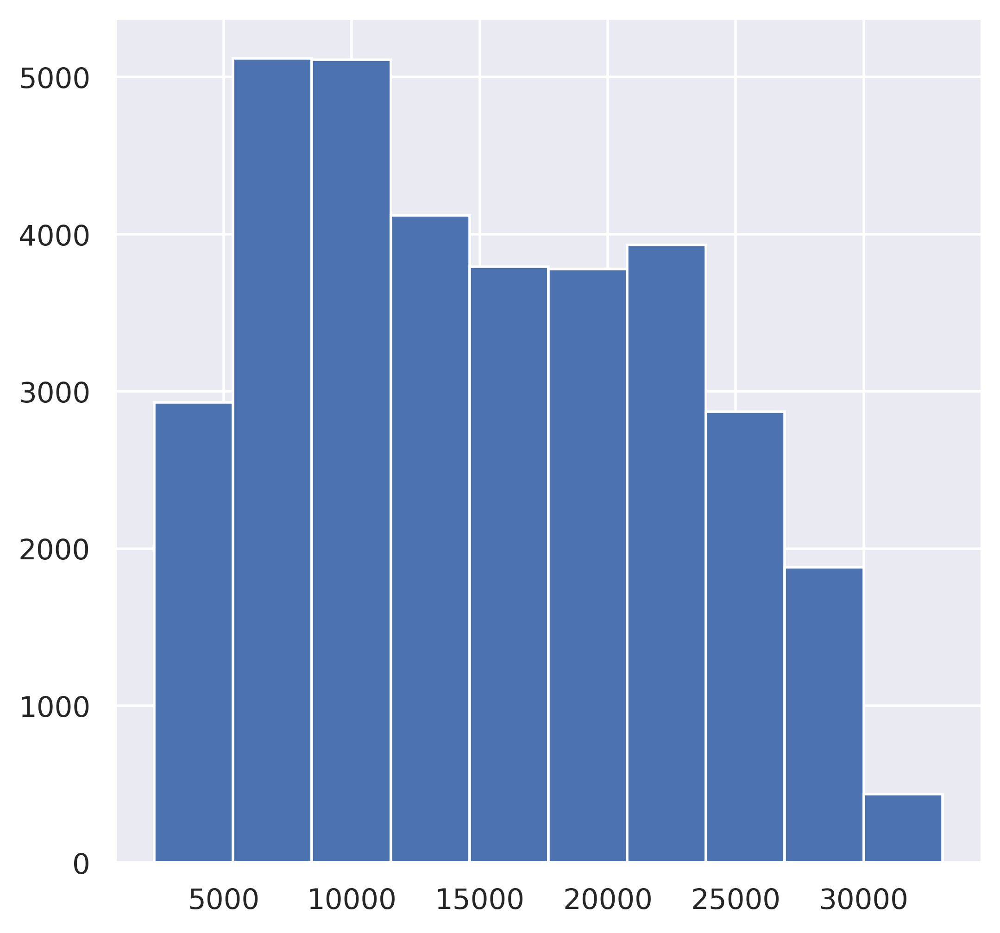

In [30]:
data = pd.DataFrame(all_dataset.X.todense())
data = log_exp2cpm(exp_df=data, log_base=2, correct=1)
data = non_log2log_cpm(input_file_path=data,  correct=1,transpose =False)
all_dataset_1 = an.AnnData(data)
all_dataset_1.X = csr_matrix(all_dataset_1.X)
all_dataset_1.obs = all_dataset.obs
all_dataset_1.var = all_dataset.var
all_dataset = all_dataset_1.copy()
print(data.max().max())  #check 
plt.figure(figsize=(6,6))
plt.hist(np.around(np.array(data.sum(axis=1)),0))
all_dataset

### 3. Principal component analysis
- Reduce the dimensionality of the data by running principal component analysis (PCA), which reveals the main axes of variation and denoises the data.

In [31]:
sc.tl.pca(all_dataset, svd_solver='arpack', n_comps=100, use_highly_variable=False, zero_center=False)

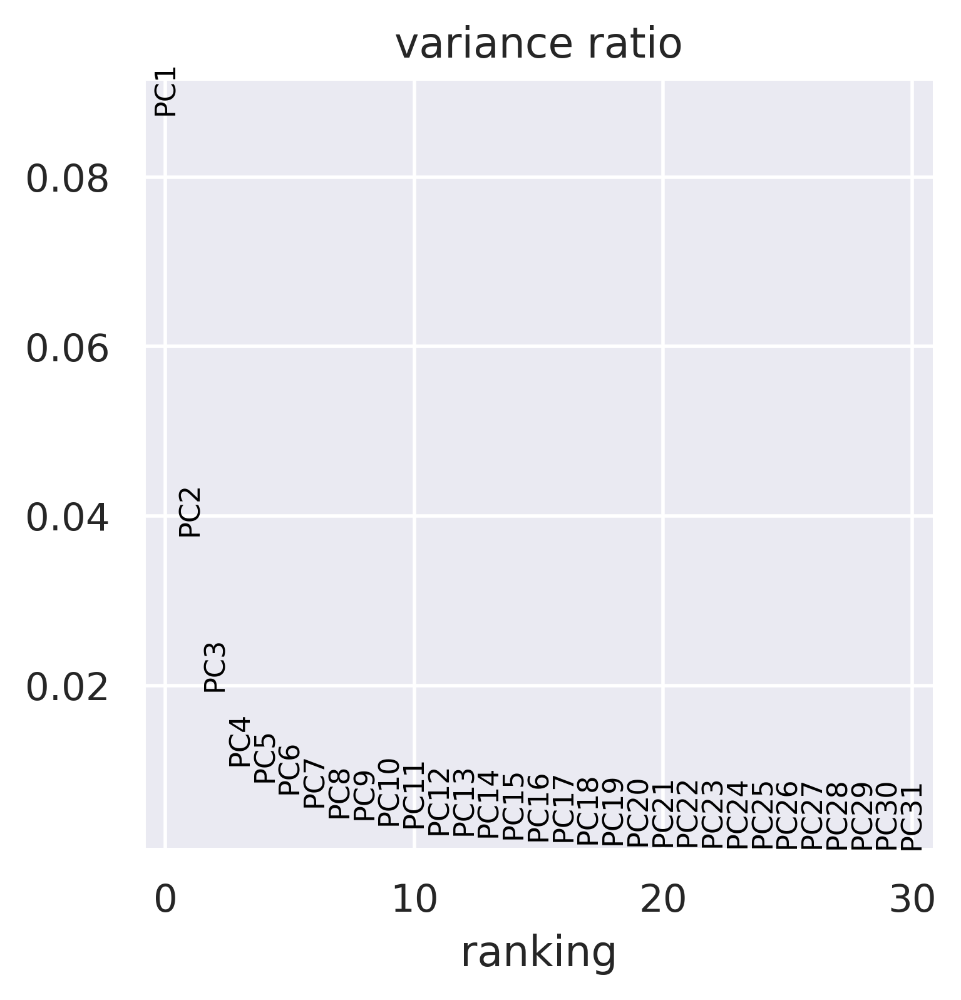

In [32]:
sc.pl.pca_variance_ratio(all_dataset, n_pcs=30)

In [33]:
all_dataset.obsm['X_pca'].shape

(33966, 100)

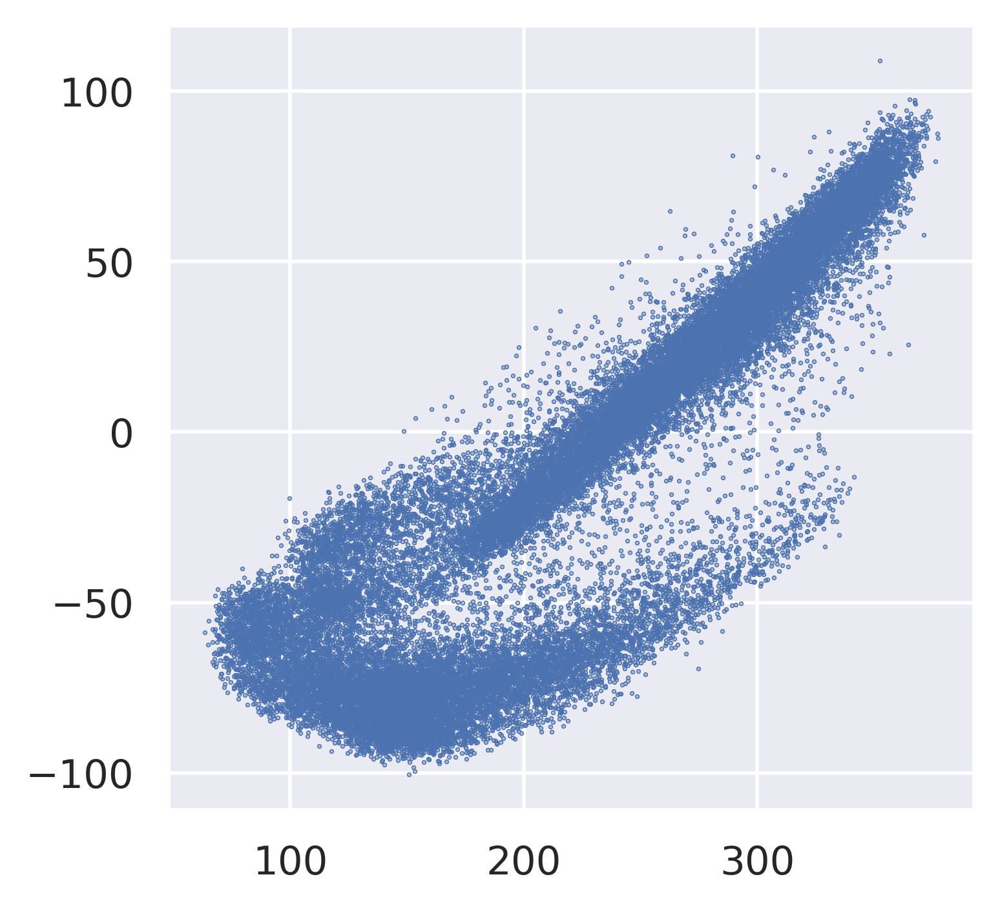

In [34]:
plt.scatter(all_dataset.obsm['X_pca'][:, 0], all_dataset.obsm['X_pca'][:, 1],s=0.1)

### 4. Computing the neighborhood graph and Embedding the neighborhood graph

In [35]:
sc.pp.neighbors(all_dataset, n_neighbors=10, n_pcs=40)  

In [36]:
sc.tl.umap(all_dataset)

In [37]:
all_dataset

AnnData object with n_obs × n_vars = 33966 × 15395
    obs: 'sample_id', 'cell_type', 'complexity', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch'
    var: 'n_cells', 'total_counts-1'
    uns: 'pca', 'neighbors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [38]:
sc.tl.leiden(all_dataset)

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


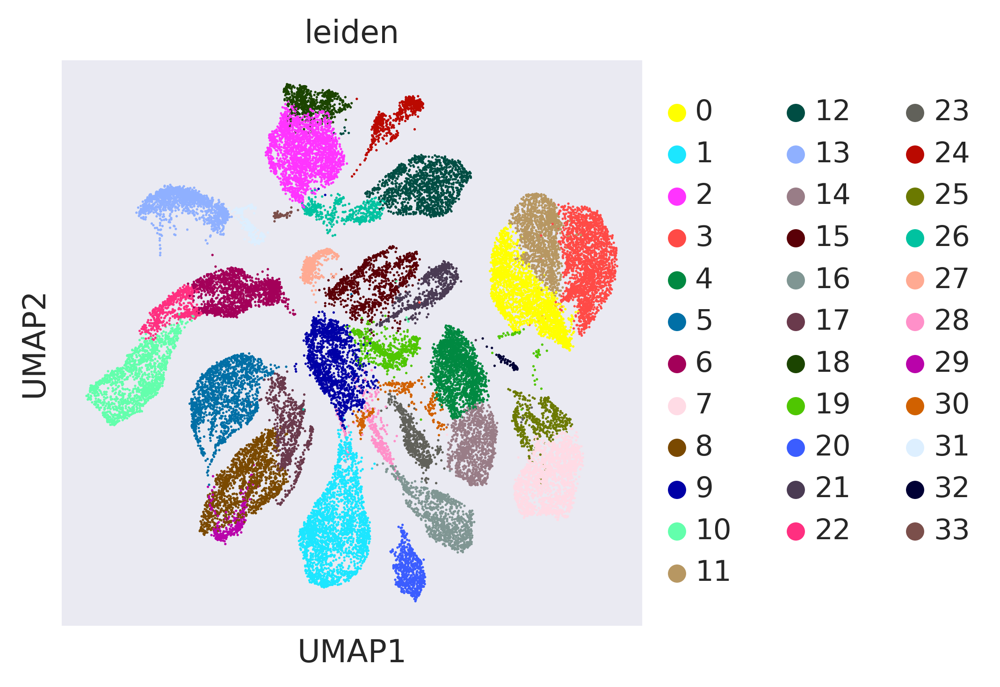

In [39]:
sc.pl.umap(all_dataset, color=['leiden'], save='before_batch_correct_umap_leiden.png')

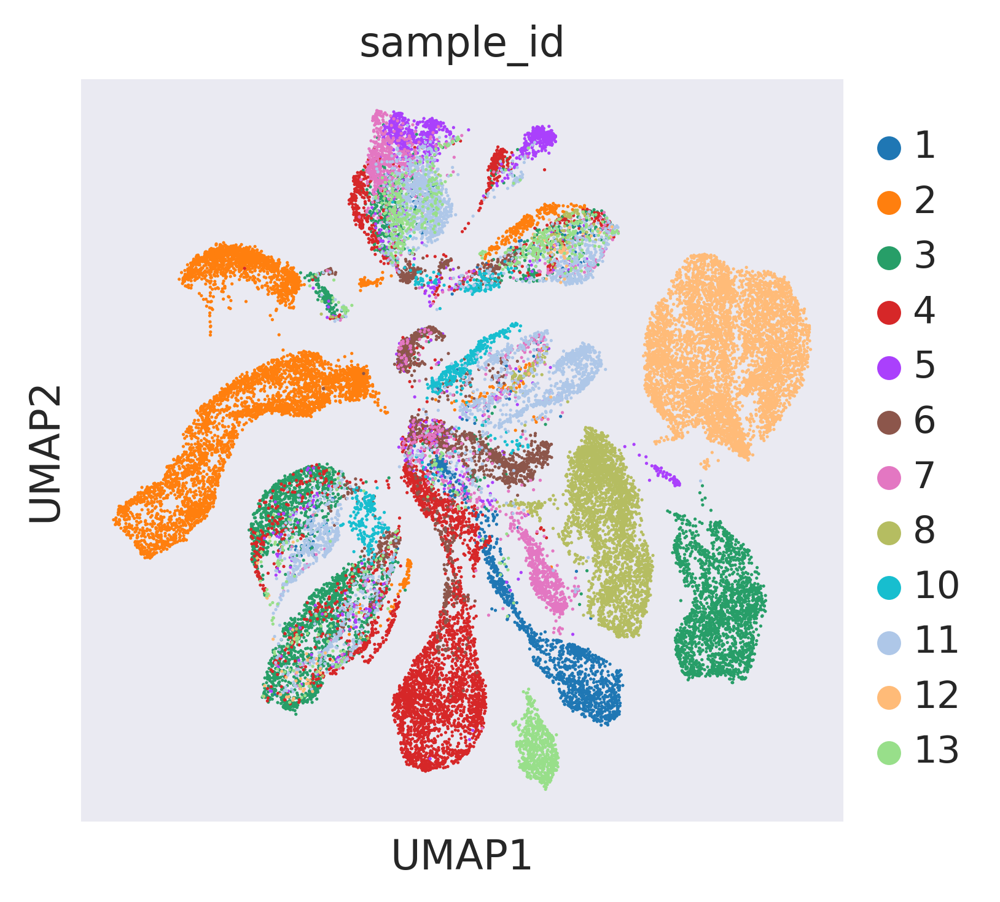

In [40]:
sc.pl.umap(all_dataset, color=['sample_id'], save='before_batch_correct_umap_batch.png')

In [41]:
all_dataset.write(os.path.join(result_dir, f'{data_set_name}_before_batch_correction.h5ad'))

5. Batch effect correction by BBKNN¶
https://scanpy-tutorials.readthedocs.io/en/latest/integrating-data-using-ingest.html#BBKNN

In [42]:
all_dataset = sc.read_h5ad(os.path.join(result_dir, f'{data_set_name}_before_batch_correction.h5ad'))

In [43]:
%%time
sc.external.pp.bbknn(all_dataset, batch_key='sample_id')

CPU times: user 15.8 s, sys: 286 ms, total: 16.1 s
Wall time: 10.4 s


In [44]:
all_dataset

AnnData object with n_obs × n_vars = 33966 × 15395
    obs: 'sample_id', 'cell_type', 'complexity', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch', 'leiden'
    var: 'n_cells', 'total_counts-1'
    uns: 'leiden', 'leiden_colors', 'neighbors', 'pca', 'sample_id_colors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [45]:
%%time
sc.tl.umap(all_dataset)
sc.tl.leiden(all_dataset)

CPU times: user 1min 18s, sys: 44.3 s, total: 2min 2s
Wall time: 1min 8s


/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


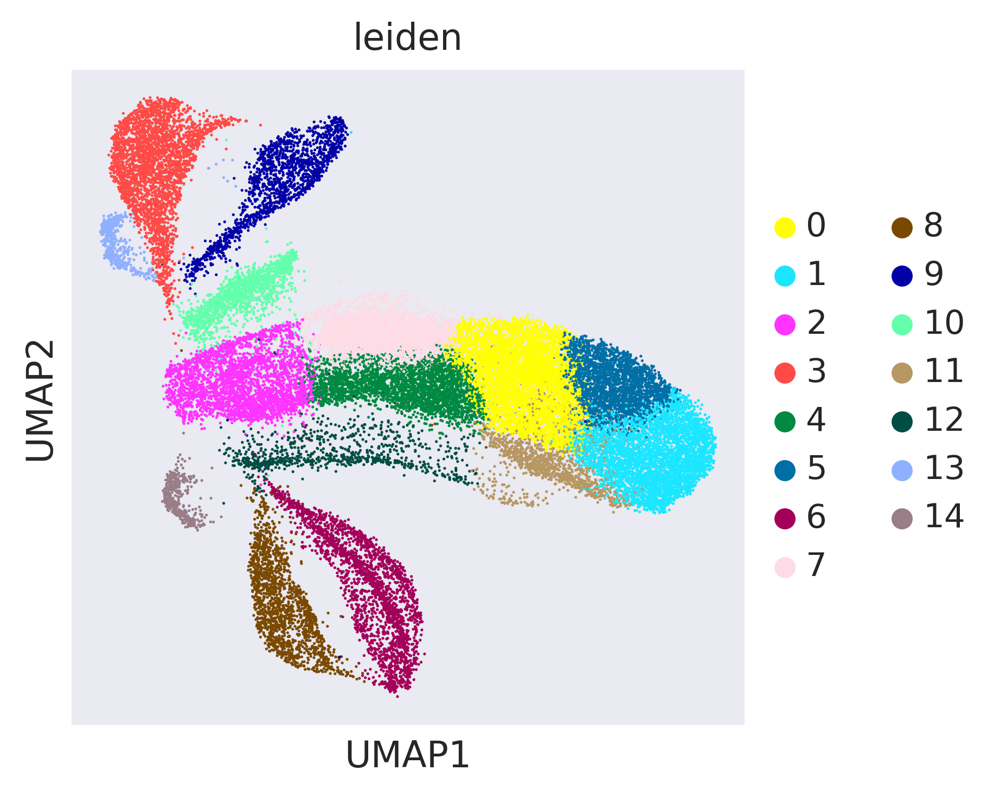

In [46]:
sc.pl.umap(all_dataset, color=['leiden'], save='after_batch_correct_umap_leiden.png')

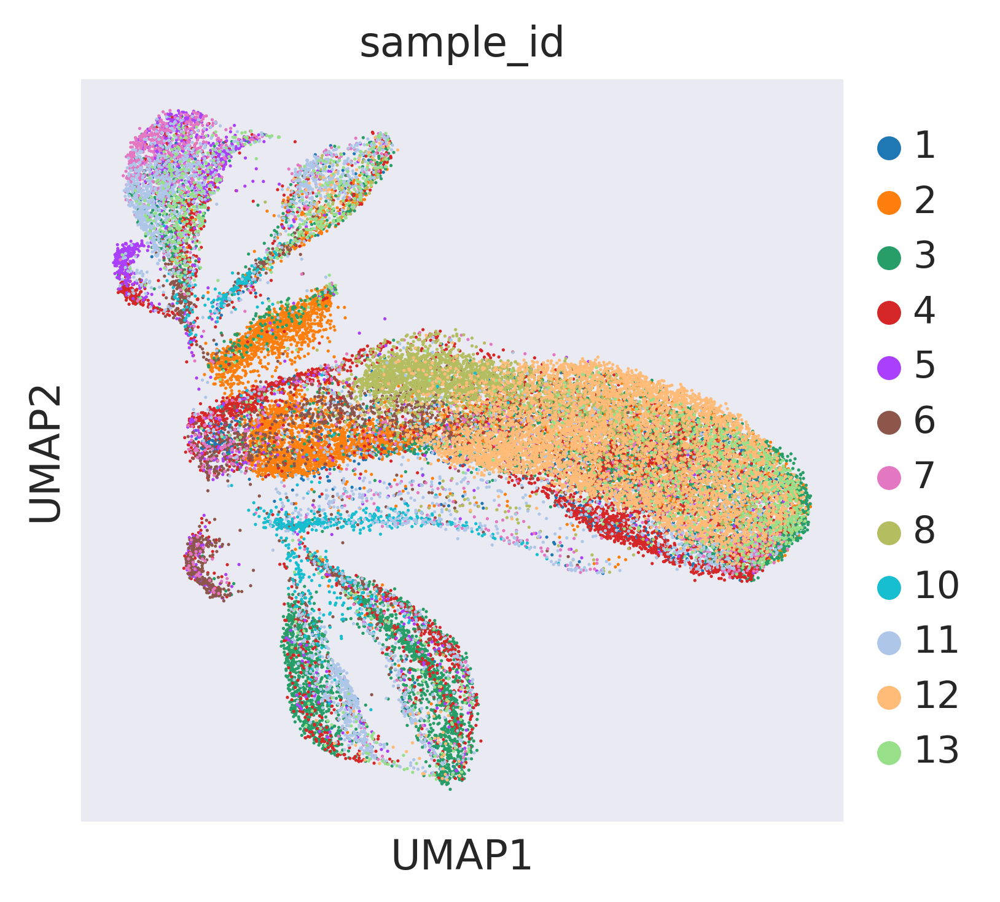

In [47]:
sc.pl.umap(all_dataset, color=['sample_id'], save='after_batch_correct_umap_batch.png')

In [48]:
all_dataset.write(os.path.join(result_dir, f'{data_set_name}_after_batch_correction_step5.h5ad'))

### 6. Finding marker genes

In [117]:
all_dataset = sc.read_h5ad(os.path.join(result_dir, f'{data_set_name}_after_batch_correction_step5.h5ad'))

In [118]:
sc.tl.rank_genes_groups(all_dataset, 'leiden', method='wilcoxon')
sc.pl.rank_genes_groups(all_dataset, n_genes=25, sharey=False)

In [119]:
top30 = pd.DataFrame(all_dataset.uns['rank_genes_groups']['names']).head(30)
top30

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14
0,STEAP2,ALDH1A3,RPL41,B2M,KLK2,PRDX4,IFI27,RPS6,CALD1,HLA-DRA,TPSB2,CD24,S100A6,CD74,RPL21
1,HEBP2,PMEPA1,KLK3,BTG1,KLK3,MGST1,IFITM3,RPL23,IGFBP7,CD74,TPSAB1,ELF3,S100A11,HLA-DRA,MT2A
2,MESP1,HEBP2,KLK2,HLA-A,PDLIM5,NUDT8,IGFBP7,RPL37,MYL9,TYROBP,CPA3,TM4SF1,KRT19,CD37,CYTL1
3,KLK2,ACPP,TFF3,CXCR4,TMPRSS2,TSPAN1,SPARCL1,RPL7A,TPM2,FTL,FTH1,CST1,GSTP1,CD79A,CLU
4,PMEPA1,NEDD4L,MSMB,IL32,SPON2,MESP1,GNG11,RPL23A,RGS5,HLA-DPA1,CD69,ITPR2,WFDC2,MS4A1,COL9A3
5,RPL8,FASN,H2AFJ,HLA-B,GDF15,MIF,RAMP2,RPL26,TAGLN,HLA-DPB1,SRGN,PPP1R1B,KRT17,CXCR4,COL2A1
6,PPP3CA,SORD,RPL26,TMSB4X,MALAT1,MRPL12,HLA-E,RPS14,SPARCL1,AIF1,RPL34,PRSS23,TACSTD2,BTG1,SERPINE2
7,NKX3-1,RBM47,FXYD3,HLA-C,TSPAN1,CREB3L4,GSN,RPL14,LGALS1,HLA-DRB1,S100A4,TBX3,ZFP36L1,CD52,S100A6
8,RPLP0,PYCR1,DBI,SRGN,VMP1,DDT,A2M,RPS7,TIMP3,GPX1,MS4A2,RNF43,ANXA2,RPS27,SCRG1
9,PDLIM5,CYB561,PDLIM5,CD52,TRIB1,DNPH1,VIM,RPL12,ADIRF,NPC2,S100A6,CLDN4,MT1X,HLA-DRB1,SPARC


In [120]:
common_marker_gene = pd.read_csv(r'../data/3CA/selected_marker_genes.csv', index_col=0)
common_marker_gene.head(2)

,cell_type,subset,PMID,comment,core_marker,corr_mean
marker_gene,,,,,,
PRSS1,Acinar,Acinar,31273297,pdac_pengj_02,NaN,NaN
PRSS1,Acinar cells,Acinar cells,"Steele, N.G. et al., Nat Cancer, 1097-1112, 2020",pdac_steele_04,NaN,NaN


In [121]:
for cluster_id in top30:
    print('Current cluster id: {}'.format(cluster_id))
    print('Cells number of current cluster: {}'.format(all_dataset.obs['leiden'].value_counts()[cluster_id]))
    print(top30.loc[:, [cluster_id]].merge(common_marker_gene, left_on=cluster_id, right_index=True).iloc[:, range(2)])

Current cluster id: 0
Cells number of current cluster: 4968
      0         cell_type
5  RPL8  Epithelial Cells
Current cluster id: 1
Cells number of current cluster: 4307
Empty DataFrame
Columns: [1, cell_type]
Index: []
Current cluster id: 2
Cells number of current cluster: 3193
        2         cell_type
21  KRT18  Epithelial Cells
21  KRT18  Epithelial Cells
Current cluster id: 3
Cells number of current cluster: 3134
       3 cell_type
10  CD3D   T Cells
13  CCL5     CD8 T
16  CD3E   T Cells
22  IL7R     CD4 T
23   CD2   T Cells
29  CREM     CD4 T
Current cluster id: 4
Cells number of current cluster: 3058
Empty DataFrame
Columns: [4, cell_type]
Index: []
Current cluster id: 5
Cells number of current cluster: 2484
         5         cell_type
6   MRPL12  Epithelial Cells
10   KRT18  Epithelial Cells
10   KRT18  Epithelial Cells
Current cluster id: 6
Cells number of current cluster: 2430
        6          cell_type
16    ENG  Endothelial Cells
24  PLVAP  Endothelial Cells
27    VW

In [122]:
marker_genes1 = ["PDCD1", "IFNG", "CD2", "CD3D", "CD3E", # T Cell
                 "BATF", "ICOS", "IL7R", "SELL", "TNFRSF4","CXCL13",  "CXCR5", "MAF", "IL12RB2", "STAT4", "CREM", "IRF4", "NR4A2",     
                 "GATA3", "STAT6", "TCF7", "IKZF2", "IL2RA", "TGFB1", "TGFB3", "TGFBR1", "CD28", "TNFRSF14", "TNFRSF9", 
                  "FOXP3","CTLA4", "TIGIT", "CCR7", "CD4",  # CD4 T                                                        
                 "CX3CR1", "CCL5", "CD8A", "CD8B", "GZMA", "LAYN", "LAG3", "GZMB", "GNLY", "NKG7", "PRF1", # CD8 T
                 "NCAM1", "XCL1", "KLRD1", "SAMD3", "TBX21"]  # NK

In [123]:
marker_genes2 = ["BANK1", "CD19", "CD22", "CD79A", "FCRL5", "FCRLA", "MS4A1", "SLAMF7", # B Cells
                 "CLEC10A", "LAMP3", "CD80", "CD83", "CLEC4C", "IRF8", "MZB1", "CD40", # DC
                 "CDH5", "CLDN5", "ENG", "PLVAP", "VWF", # Endothelial Cells
                 "COL1A1", "COL1A2", "COL3A1", "DCN", "FAP", "LUM", "MYL9",  # Fibroblasts
                 "AIF1", "CD14", "CD163", "CD68", "CTSB", "FCGR2A", "FCGR3B", "LYZ", "MARCO", "MS4A7", "FCGR3A", # Macrophages
                 "CMA1", "MS4A2", "TPSAB1", # Mast Cells
                 "CFLAR", "CSF3R", "CXCR2", "FPR1", "S100A8", "S100A9", "SLC25A37", # Neutrophils
                 "CDH1", "EPCAM", "KRT18", "KRT19", 'KRT5', 'KRT8']  # Epithelial cells

In [124]:

list_marker1 = set(all_dataset.var.index) & set(marker_genes1)
missing_gene = set(marker_genes1)-set(list_marker1)
print(f'Marker gene {missing_gene} of marker_genes1 list are missing.')
for i in missing_gene:
    marker_genes1.remove(i)
len(marker_genes1)

Marker gene set() of marker_genes1 list are missing.


50

In [125]:
list_marker2 = set(all_dataset.var.index) & set(marker_genes2)
missing_gene = set(marker_genes2)-set(list_marker2)
print(f'Marker gene {missing_gene} of marker_genes2 list are missing.')
for i in missing_gene:
    marker_genes2.remove(i)
len(marker_genes2)

Marker gene {'FCGR3B', 'CLEC4C', 'CMA1'} of marker_genes2 list are missing.


52

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


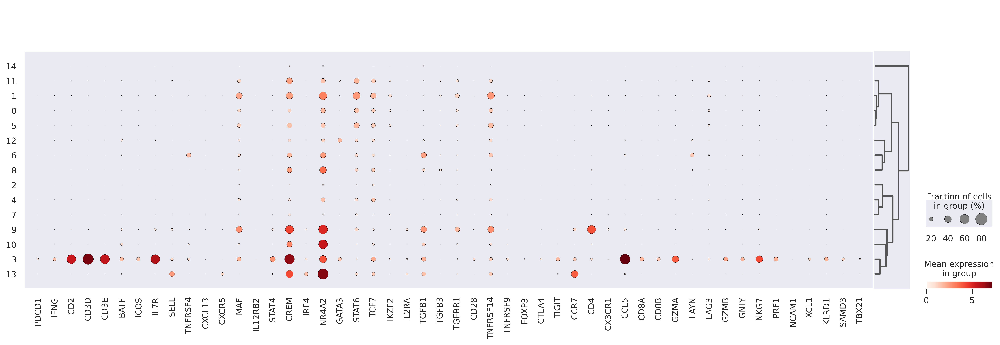

In [126]:
sc.pl.dotplot(all_dataset, marker_genes1, groupby='leiden', save='marker_genes_dotplot1.png', dendrogram=True)

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


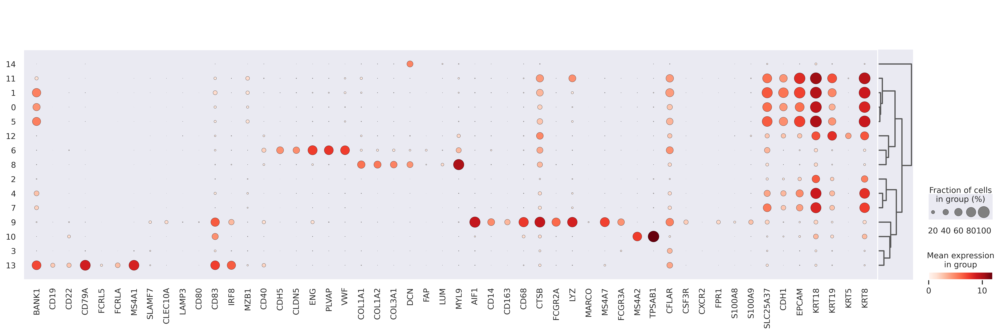

In [127]:
sc.pl.dotplot(all_dataset, marker_genes2, groupby='leiden', save='marker_genes_dotplot2.png', dendrogram=True)


In [128]:
#  Exhausted CD8 T (Tex)
# follicular T helper (Tfh)
# Plasmacytoid dendritic cells (pDC)
new_cluster_names = {
    0: 'Epithelial Cells (1)',
    1: 'Maglignent (1)',
    2: 'Epithelial Cells (2)',
    3: 'CD8 T / CD4 T',
    4: 'Maglignent (2)',
    5: 'Epithelial Cells (3)',
    6: 'Endothelial Cells',
    7: 'Maglignent (3)',
    8: 'Fibroblasts',
    9: 'Macrophages',
    10: 'Mast Cells',
    11: "Epithelial Cells (4)",
    12: 'Epithelial Cells (5)',
    13: 'B Cells',
    14: 'Epithelial Cells / Fibroblasts'
}
new_cluster_names_val = list(new_cluster_names.values())
print(new_cluster_names_val)
all_dataset.rename_categories('leiden', new_cluster_names_val)

['Epithelial Cells (1)', 'Maglignent (1)', 'Epithelial Cells (2)', 'CD8 T / CD4 T', 'Maglignent (2)', 'Epithelial Cells (3)', 'Endothelial Cells', 'Maglignent (3)', 'Fibroblasts', 'Macrophages', 'Mast Cells', 'Epithelial Cells (4)', 'Epithelial Cells (5)', 'B Cells', 'Epithelial Cells / Fibroblasts']


/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


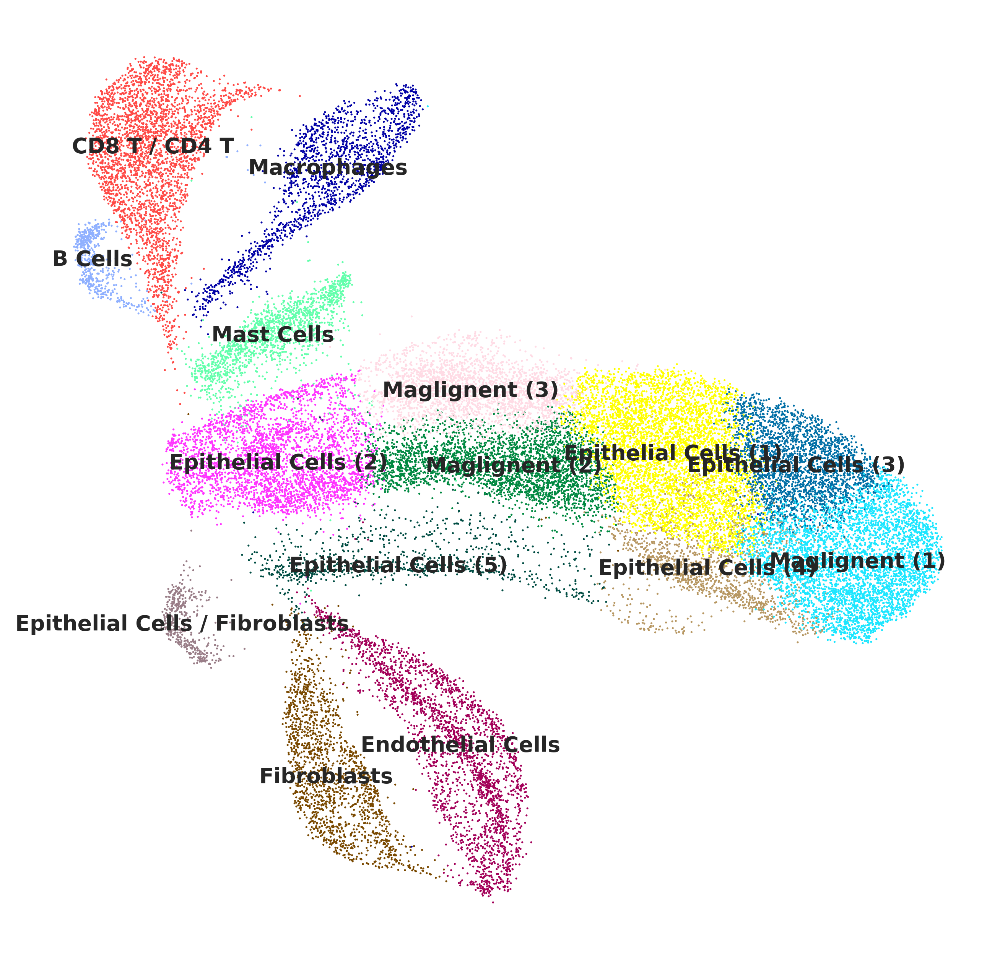

In [129]:
# plt.figure(figsize=(10, 10))
rcParams['figure.figsize'] = 8, 8
sc.pl.umap(all_dataset, color='leiden', legend_loc='on data', legend_fontsize='small', title='', frameon=False, save='.png')

In [130]:
all_dataset

AnnData object with n_obs × n_vars = 33966 × 15395
    obs: 'sample_id', 'cell_type', 'complexity', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch', 'leiden'
    var: 'n_cells', 'total_counts-1'
    uns: 'leiden', 'leiden_colors', 'neighbors', 'pca', 'sample_id_colors', 'umap', 'rank_genes_groups', 'dendrogram_leiden'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [131]:
all_dataset.write(os.path.join(result_dir, f'{data_set_name}_after_batch_correction.h5ad'))

#### Comparing original cell type and annotated cell type

In [79]:
all_dataset = sc.read_h5ad(os.path.join(result_dir, f'{data_set_name}_after_batch_correction.h5ad'))

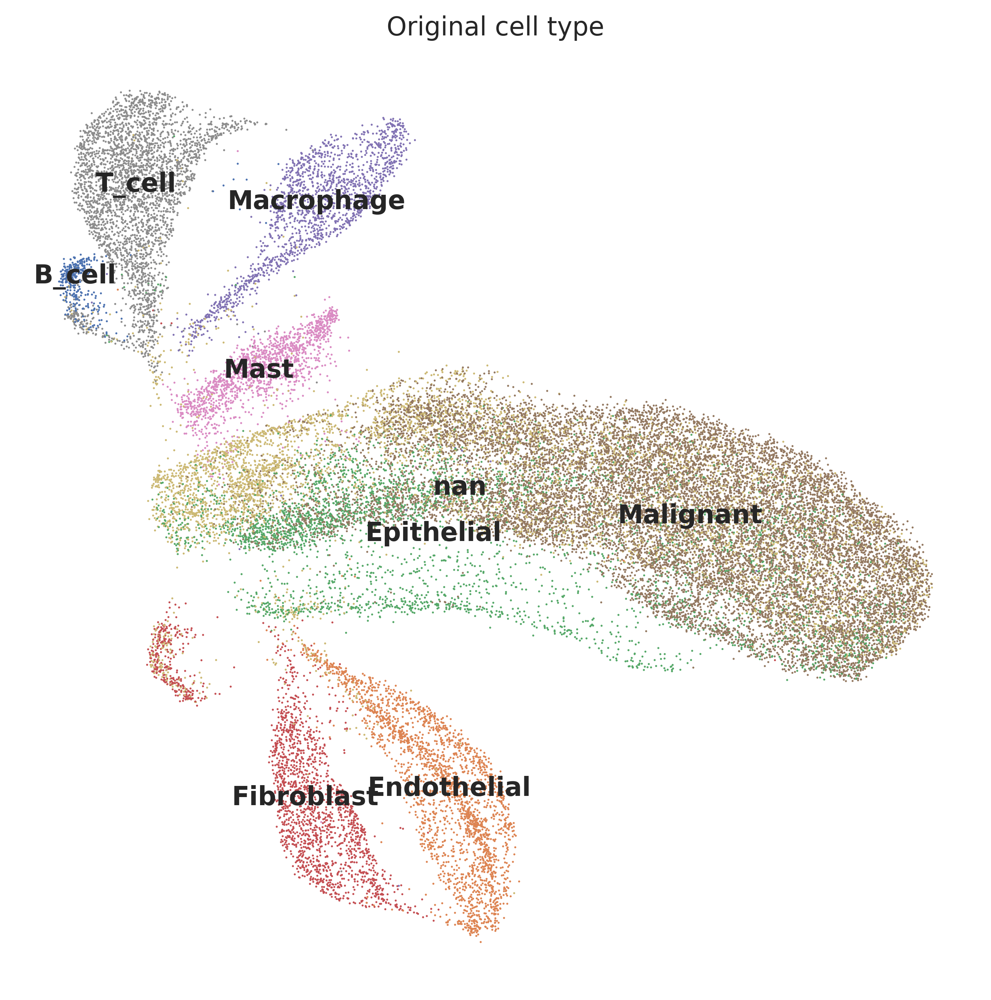

In [132]:
sc.pl.umap(all_dataset, color='cell_type', legend_loc='on data', legend_fontsize='medium', title='Original cell type', frameon=False, save='literature.png')

In [133]:
sorted(list(all_dataset.obs.leiden.unique()))

['B Cells',
 'CD8 T / CD4 T',
 'Endothelial Cells',
 'Epithelial Cells (1)',
 'Epithelial Cells (2)',
 'Epithelial Cells (3)',
 'Epithelial Cells (4)',
 'Epithelial Cells (5)',
 'Epithelial Cells / Fibroblasts',
 'Fibroblasts',
 'Macrophages',
 'Maglignent (1)',
 'Maglignent (2)',
 'Maglignent (3)',
 'Mast Cells']

In [135]:
cell_type_mapping = {
    'B Cells': 'B Cells',
 'CD8 T / CD4 T': 'T Cells',
 'Endothelial Cells': 'Endothelial Cells',
 'Epithelial Cells (1)': 'Cancer Cells',
 'Epithelial Cells (2)': 'Cancer Cells',
 'Epithelial Cells (3)': 'Cancer Cells',
 'Epithelial Cells (4)': 'Cancer Cells',
 'Epithelial Cells (5)': 'Cancer Cells',
 'Epithelial Cells / Fibroblasts': 'Fibroblasts',
 'Fibroblasts': 'Fibroblasts',
 'Macrophages': 'Macrophages' ,
 'Maglignent (1)': 'Cancer Cells',
 'Maglignent (2)': 'Cancer Cells',
 'Maglignent (3)': 'Cancer Cells',
 'Mast Cells': 'Mast Cells',
}


In [136]:
all_dataset.obs['cell_type'].unique()

['Malignant', 'nan', 'Epithelial', 'Endothelial', 'Fibroblast', 'Macrophage', 'T_cell', 'Mast', 'B_cell']
Categories (9, object): ['Malignant', 'nan', 'Epithelial', 'Endothelial', ..., 'Macrophage', 'T_cell', 'Mast', 'B_cell']

In [137]:
cell_type_mapping_original = {
    'Malignant':'Cancer Cells', 
    'nan':'nan', 
    'Epithelial':'Cancer Cells', 
    'Endothelial':'Endothelial Cells', 
    'Fibroblast':'Fibroblasts', 
    'Macrophage':'Macrophages', 
    'T_cell':'T Cells', 
    'Mast':'Mast Cells', 
    'B_cell':'B Cells'
}

In [138]:
all_dataset.obs['leiden'].value_counts()

Epithelial Cells (1)              4968
Maglignent (1)                    4307
Epithelial Cells (2)              3193
CD8 T / CD4 T                     3134
Maglignent (2)                    3058
Epithelial Cells (3)              2484
Endothelial Cells                 2430
Maglignent (3)                    2406
Fibroblasts                       1659
Macrophages                       1589
Mast Cells                        1558
Epithelial Cells (4)              1395
Epithelial Cells (5)               844
B Cells                            517
Epithelial Cells / Fibroblasts     424
Name: leiden, dtype: int64

In [139]:
all_dataset.obs['cell_type1'] = all_dataset.obs.leiden.map(cell_type_mapping)
all_dataset.obs['original_cell_type'] = all_dataset.obs['cell_type'].map(cell_type_mapping_original)
all_dataset.obs.head(2)

,sample_id,cell_type,complexity,n_genes,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,batch,leiden,cell_type1,original_cell_type
cell_name,,,,,,,,,,,,
GAACCTAAGGTCATCT.1,1,Malignant,2643,2643,2640,999628.896586,0.0,0.0,0,Epithelial Cells (1),Cancer Cells,Cancer Cells
TTGACTTTCGGACAAG.1,1,Malignant,2543,2543,2535,999153.349561,0.0,0.0,0,Epithelial Cells (1),Cancer Cells,Cancer Cells


In [141]:
obs_bool = (all_dataset.obs['cell_type1'] == all_dataset.obs['original_cell_type'])|(all_dataset.obs['cell_type1'] =='nan')|(all_dataset.obs['original_cell_type']=='nan')
print(sum(obs_bool))
all_dataset = all_dataset[obs_bool, :].copy()

33638


In [142]:
for i, group in all_dataset.obs.groupby(['leiden']):
    n_cell = group.shape[0]
    accuracy = np.sum(group['cell_type1'] == group['original_cell_type']) / n_cell  # annotated same cell type as original cell type
    print(i, round(accuracy, 3), n_cell)

Epithelial Cells (1) 0.798 4965
Maglignent (1) 0.844 4303
Epithelial Cells (2) 0.478 3179
CD8 T / CD4 T 0.979 3120
Maglignent (2) 0.868 3045
Epithelial Cells (3) 0.857 2483
Endothelial Cells 0.976 2409
Maglignent (3) 0.624 2399
Fibroblasts 0.992 1638
Macrophages 0.974 1578
Mast Cells 0.972 1540
Epithelial Cells (4) 0.992 1394
Epithelial Cells (5) 0.893 821
B Cells 0.938 340
Epithelial Cells / Fibroblasts 0.696 424


In [147]:
all_dataset.obs['leiden'].value_counts()

Epithelial Cells (1)              4965
Maglignent (1)                    4303
Epithelial Cells (2)              3179
CD8 T / CD4 T                     3120
Maglignent (2)                    3045
Epithelial Cells (3)              2483
Endothelial Cells                 2409
Maglignent (3)                    2399
Fibroblasts                       1638
Macrophages                       1578
Mast Cells                        1540
Epithelial Cells (4)              1394
Epithelial Cells (5)               821
Epithelial Cells / Fibroblasts     424
B Cells                            340
Name: leiden, dtype: int64

In [143]:
all_dataset

AnnData object with n_obs × n_vars = 33638 × 15395
    obs: 'sample_id', 'cell_type', 'complexity', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch', 'leiden', 'cell_type1', 'original_cell_type'
    var: 'n_cells', 'total_counts-1'
    uns: 'leiden', 'neighbors', 'pca', 'sample_id_colors', 'umap', 'rank_genes_groups', 'dendrogram_leiden', 'cell_type_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


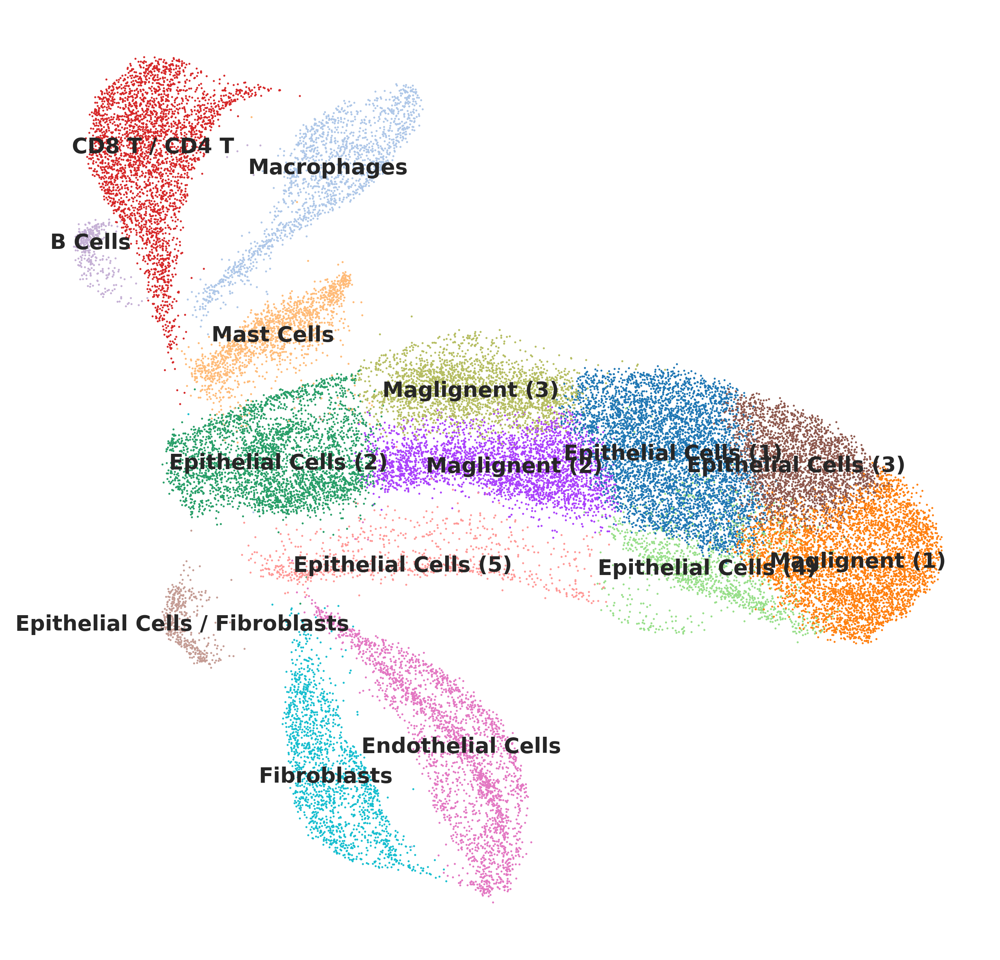

In [144]:
# plt.figure(figsize=(10, 10))
rcParams['figure.figsize'] = 8, 8
sc.pl.umap(all_dataset, color='leiden', legend_loc='on data', legend_fontsize='small', title='', frameon=False, save='_new.png')

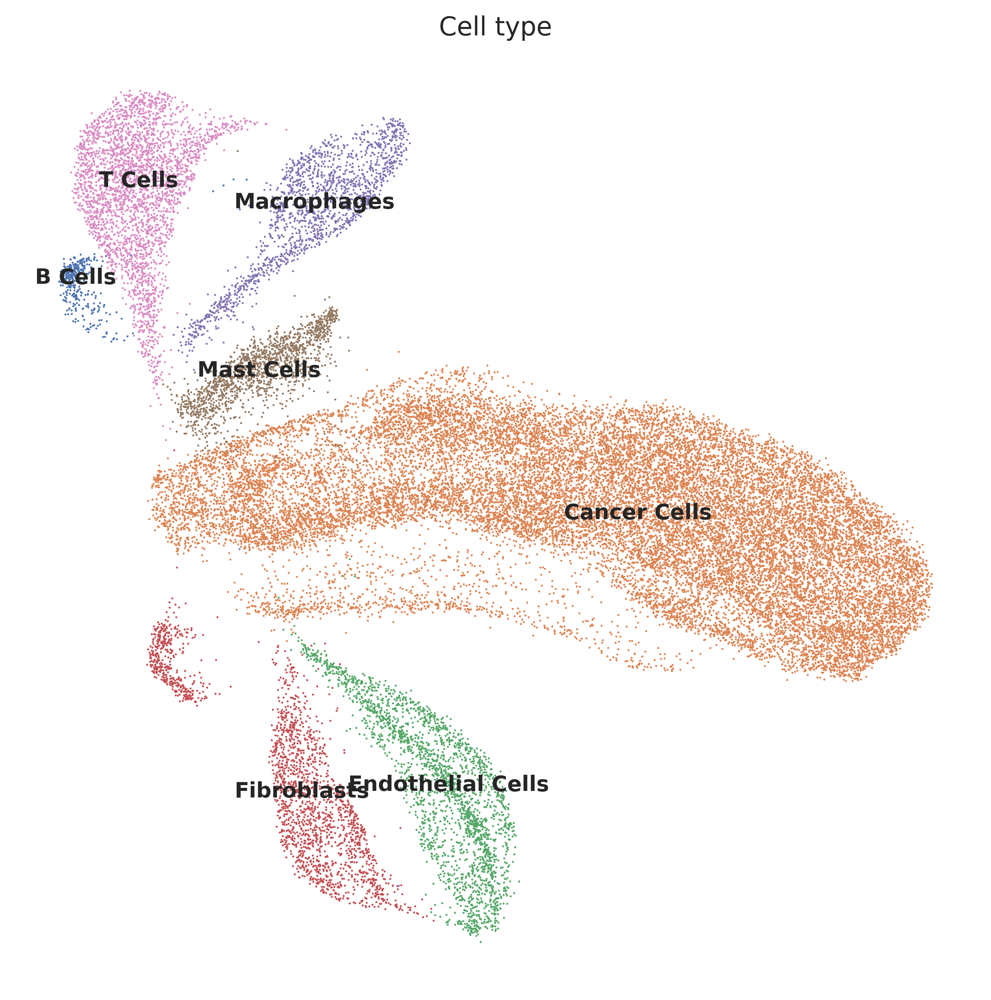

In [145]:
sc.pl.umap(all_dataset, color='cell_type1', legend_loc='on data', legend_fontsize='small', 
           title='Cell type', frameon=False)

In [146]:
all_dataset.write(os.path.join(result_dir, f'{data_set_name}_after_batch_correction.h5ad'))